# Librerias Utilizadas

In [1]:
import random
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.patches as mpatches
import statistics
import emoji

from sklearn import metrics
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer 
from nltk.tokenize import word_tokenize
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from nltk.corpus import stopwords
from gensim.models import Word2Vec
from string import punctuation
from nltk.tokenize import sent_tokenize, word_tokenize
from emot.emo_unicode import UNICODE_EMOJI
from emot.emo_unicode import EMOTICONS_EMO

from collections import Counter
from itertools import groupby
from mpl_toolkits.mplot3d import Axes3D
from scipy import stats

# Funciones Utilizadas

In [2]:
def stopwords(text):
    return " ".join([word for word in str(text).split() if word not in STOPWORDS])

def Plot2D (samples_2D, title, axes = {'x': 'x', 'y': 'y'}):

  """
  samples_2D (numpy.ndarray): array tipo embedding cuyo
        shape es (num_muestras, 2) ; 2 por las dos coordenadas

  title(string): titulo de la figura que se utiliza para el plot
  """

  df_samples_2D = pd.DataFrame(data=samples_2D, columns=[axes['x'], axes['y']])

  sns.set(font_scale=3)
  sns.set(rc={'figure.figsize':(10,10)})
  sns.relplot(data=df_samples_2D,
              x=axes['x'],
              y=axes['y'],
              height=10, legend="full", palette="bright")

  set_size_letters(title,
                   axes['x'],
                   axes['y'],
                   active_legend = False)
  plt.axis('equal')

def Plot2D_WithLabels (samples_2D, labels, title, axes = {'x': 'x', 'y': 'y'}, palette="bright", centroids_2D=None):

  """
  samples_2D (numpy.ndarray): array tipo embedding cuyo
        shape es (num_muestras, 2) ; 2 por las dos coordenadas

  labels (array): etiqueta perteneciente a cada muestra.

  title(string): titulo de la figura que se utiliza para el plot
  """

  # First we create the dataframe
  df_samples_2D_labeled = pd.DataFrame(data=samples_2D, columns=[axes['x'], axes['y']])

  # Then we add the labels column
  df_samples_2D_labeled['label'] = labels.tolist()

  if centroids_2D is not None:
    labels_centroid_aux = np.arange(len(centroids_2D), dtype=int)
    df_centroids_2D_labeled = pd.DataFrame(data=centroids_2D, columns=[axes['x'], axes['y']])
    df_centroids_2D_labeled['label'] = labels_centroid_aux.tolist()

  sns.set(font_scale=3)
  sns.set(rc={'figure.figsize':(10,10)})
  sns.relplot(data=df_samples_2D_labeled,
              x=axes['x'],
              y=axes['y'],
              hue="label", height=10, legend="full", palette=palette)

  if centroids_2D is not None:
    # First we plot the centroids
    sns.scatterplot(data=df_centroids_2D_labeled,
              x=axes['x'],
              y=axes['y'],
              hue="label",
              legend=False, palette=palette, s=100)

    # Then we plot their labels
    plot_2D_centroid_labels(df_centroids_2D_labeled, plt.gca())

  set_size_letters(title,
                   axes['x'],
                   axes['y'],
                   active_legend = False)
  plt.axis('equal')

def plot_2D_centroid_labels(df_centroids, ax):
    for index, row in df_centroids.iterrows():
      ax.text(row[0]+.5, row[1], 'C'+str(row[2].astype(int)), fontsize = 20, color='black', weight='semibold')
def set_size_letters(title, x_name, y_name, title_size = 20, x_size = 18, y_size = 18, active_legend = True, legend_size = 14):

  """
  Parameters:
    title (string): titulo del plot a representar

    x_name (string): nombre del eje x

    y_name (string): nombre del eje y

    active_legend (bool): indica si mostramos la leyenda o no. Por defecto True

    x_size, y_size, legend_size: tamaño de fuente de eje x, y, leyenda

  """

  plt.title(title, fontsize=title_size)
  plt.xlabel(x_name, fontsize=x_size)
  plt.ylabel(y_name, fontsize=y_size)
  if (active_legend == True):
    plt.legend(fontsize=legend_size)

def Plot3D_WithLabels (samples_3D, labels, title, axes = {'x': 'x', 'y': 'y', 'z': 'z'}, centroids_3D=None):

  """
  samples_3D (numpy.ndarray): array tipo embedding cuyo
        shape es (num_muestras, 3) ; 3 por las tres coordenadas

  labels (array): etiqueta perteneciente a cada muestra.

  title(string): titulo de la figura que se utiliza para el plot
  """

  # First we create the dataframe
  df_samples_3D_labeled = pd.DataFrame(data=samples_3D, columns=[axes['x'], axes['y'], axes['z']])

  # Then we add the labels column
  df_samples_3D_labeled['label'] = labels.tolist()
  df_samples_3D_labeled['label'] = df_samples_3D_labeled["label"].astype(str)

  if centroids_3D is not None:
    # Same applies for centroids when these are provided as an argument
    labels_centroid_aux = np.arange(len(centroids_3D), dtype=int)
    df_centroids_3D_labeled = pd.DataFrame(data=centroids_3D, columns=[axes['x'], axes['y'], axes['z']])
    df_centroids_3D_labeled['label'] = labels_centroid_aux.tolist()

    # We create an additional column with the dot size used for each type of sample
    size_no_centroid = np.ones(len(samples_3D)) * 10 # for regular samples
    size_centroid = np.ones(len(centroids_3D)) * 50 # for centroids
    size_col = np.append(size_no_centroid, size_centroid) # new col to be added to the dataframe

    # We also create another additional column with the labels for each type of sample
    no_es_centroide_aux = [' '] * len(samples_3D) # empty label for regular samples
    es_centroide_aux = []
    for i in range(len(centroids_3D)):
      es_centroide_aux.append('C%d' % i) # Ci label for centroid i
    centroid_col = no_es_centroide_aux + es_centroide_aux # new col to be added to the dataframe

    # Next we concatenate both dataframes: first, regular samples, then, centroids
    df_samples_and_centroids = pd.concat([df_samples_3D_labeled, df_centroids_3D_labeled], ignore_index=True)
      

    # We add the new column with the labels distinguishing regular samples from centroids
    df_samples_and_centroids['centroid'] = centroid_col

    # New column is re-casted as a string column
    df_samples_and_centroids['centroid'] = df_samples_and_centroids['centroid'].astype(str)

    # We add the new column with the corresponding size for both regular samples and centroids
    df_samples_and_centroids['size'] = size_col

    # We ensure that the 'label' column is numeric since we will sort the dataframe upon this one
    df_samples_and_centroids['label'] = pd.to_numeric(df_samples_and_centroids['label'])

    # We finally sort the dataframe by the 'label' column in ascending order
    df_samples_and_centroids_sorted = df_samples_and_centroids.sort_values(by=['label'], ascending=True)

    # And plot both the samples and their corresponding centroids
    fig = px.scatter_3d(df_samples_and_centroids_sorted, x=axes['x'], y=axes['y'], z=axes['z'], text='centroid', size='size', color='label')
  else:
    # We ensure that the 'label' column is numeric since we will sort the dataframe upon this one
    df_samples_3D_labeled['label'] = pd.to_numeric(df_samples_3D_labeled['label'])

    # We finally sort the dataframe by the 'label' column in ascending order
    df_samples_and_centroids_sorted = df_samples_3D_labeled.sort_values(by=['label'], ascending=True)

    fig = px.scatter_3d(df_samples_and_centroids_sorted, x=axes['x'], y=axes['y'], z=axes['z'], color='label', size=np.ones(len(samples_3D))) #, color_continuous_scale='delta')

  fig.update_traces(textposition='top center')
  fig.update_layout(scene_aspectmode='data')
  fig.update_layout(uniformtext_minsize=60)

  fig.update_layout(title_font_size=20,
                    title={
                    'text': title,
                    'y': 0.9,
                    'x': 0.05,
                    'xanchor': 'left',
                    'yanchor': 'top'})
  # tight layout
  fig.update_layout(autosize = True, margin = dict(l=50, r=0, b=10, t=30))
  fig.show()

def ApplyDBScanToData (samples, epsilon, min_samples = 30):

  """
  Parameters:

    samples (numpy.ndarray): array tipo embedding cuyo
        shape es (n_ejemplo,n_muestras_por_ejemplo)

    epsilon: int con el valor de epsilon (distancia mínima entre elementos
        para formar un cluster)

    min_samples (int): numero minimo de muestras para generar un cluster

    include_noise (bool): permite seleccionar si se quiere incluir el cluster
        de ruido en el cálculo de la silueta o no. Por defecto no se incluye.
        Se debe incluir cuando únicamente se detecta un cluster, para poder
        realizar la evaluación.

  Return:

    labels: lista con el cluster al que pertenece cada ejemplo de data. Cluster
        -1 significa ruido.
  """


  db = DBSCAN(eps=epsilon, min_samples=min_samples).fit(samples)

  core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
  core_samples_mask[db.core_sample_indices_] = True
  labels = db.labels_

  # Number of clusters in labels, ignoring noise if present.
  n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
  n_noise_ = list(labels).count(-1)

  print(f"\nTest for epsilon = {epsilon}")
  print('Estimated number of clusters: %d' % n_clusters_)
  print('Estimated number of noise points: %d' % n_noise_)
  print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(samples, labels))


  return labels

def CreateFeatureVectors(data):
  num_nodes = 63
  num_rows, num_cols = data.shape # shape: devuelve las dimensiones de nuestro array (matriz en este caso) numpy
  num_measures_per_node = num_cols # 3 (i.e. temperatura, humedad y presión)
  num_samples = int(num_rows / num_nodes)

  samples = np.zeros((num_samples, num_nodes*num_cols)) # para crear una nueva matriz "samples" rellena de ceros y de dimensiones (4070, 189)

  # recordemos que "data" es una matriz (256410, 3)
  n_row = 0 # hasta num_samples
  n_col = 0 # hasta num_nodes*num_cols = 189

  for i in range(num_rows): # recorremos todas las filas de la matriz original (256410, 3)
    for elem in data[i]: # añadimos a la fila los valores de cada nodo de 3 en 3 hasta agotar los del timestamp específico
      if (n_col == num_nodes*num_measures_per_node): # si llenamos la fila, pasamos a la siguiente (siguiente timestamp)
        n_col = 0
        n_row += 1 # siguiente fila
      samples[n_row, n_col] = elem
      n_col += 1

  return samples

def PlotDistancesToKnearestNeighbor(data_vector, K):

  """
  Parameters:
    data_vector (numpy.ndarray): array tipo embedding cuyo
        shape es (n_ejemplo,n_muestras_por_ejemplo)

    k: posición del k-esimo vecino más cercano

  """

  nbrs = NearestNeighbors(n_neighbors=K).fit(data_vector)
  distances, indices = nbrs.kneighbors(data_vector)
  distances = np.sort(distances, axis=0)
  distances = distances[:,K-1]
  plt.figure(figsize=(10,8))
  set_size_letters(f"Distancias al K-vecino más cercano (K={K})",
                   f"Points sorted according to distance of the {K}-th nearest neighbor",
                   f"{K}-th nearest neighbor distance")
  plt.plot(distances)

def preprocess_text(text):
    text = text.lower()  # Lowercase text
    text = re.sub(r"https?://\S+", "", text)
    text = re.sub(r"\b[0-9]+\b\s*", "", text)
    text = re.sub(f"[{re.escape(punctuation)}]", "", text)  # Remove punctuation
    text = " ".join(text.split())  # Remove extra spaces, tabs, and new lines
    return text

# Texto Tweets

In [3]:
dataset1 = pd.read_csv("APAUtweets.txt", header=None, delimiter = "\t", encoding = 'utf8')
dataset1.set_index(0, inplace = True)
dataset1.rename(columns={1: "text"}, inplace = True)
dataset1

,text
0,
0,La Gran Guerra de #JuegoDeTronos nos ha dejado...
1,El golpe de Estado en #Venezuela está más lejo...
2,No tengo una foto en la catedral de #NotreDame...
3,#NotreDame nunca llegue a visitar tan grandios...
4,A tomar por culo mi crush 😭😭😭😭😭#JuegoDeTronos
...,...
8218,"#ChampionsLeague 83’ Gooooooool de Messi, que ..."
8219,Llegarán más venezolanos y la crisis humanitar...
8220,Hoy estamos de fiesta y deberías visitarnos. #...


## Preprocesado

### Cambio a minusculas

In [4]:
dataset1["text_lower"] = dataset1["text"].map(preprocess_text)
dataset1

,text,text_lower
0,,
0,La Gran Guerra de #JuegoDeTronos nos ha dejado...,la gran guerra de juegodetronos nos ha dejado ...
1,El golpe de Estado en #Venezuela está más lejo...,el golpe de estado en venezuela está más lejos...
2,No tengo una foto en la catedral de #NotreDame...,no tengo una foto en la catedral de notredame ...
3,#NotreDame nunca llegue a visitar tan grandios...,notredame nunca llegue a visitar tan grandiosa...
4,A tomar por culo mi crush 😭😭😭😭😭#JuegoDeTronos,a tomar por culo mi crush 😭😭😭😭😭juegodetronos
...,...,...
8218,"#ChampionsLeague 83’ Gooooooool de Messi, que ...",championsleague ’ gooooooool de messi que peda...
8219,Llegarán más venezolanos y la crisis humanitar...,llegarán más venezolanos y la crisis humanitar...
8220,Hoy estamos de fiesta y deberías visitarnos. #...,hoy estamos de fiesta y deberías visitarnos dí...


### Borramos palabras tipicas

In [5]:
#Con esto sacamos palabras tipicas de habla hispana.
from nltk.corpus import stopwords
STOPWORDS = set(stopwords.words('spanish'))

In [6]:
def stopwords(text):
    return " ".join([word for word in str(text).split() if word not in STOPWORDS])

dataset1["text_stop"] = dataset1["text_lower"].apply(stopwords)
dataset1.head()

,text,text_lower,text_stop
0,,,
0,La Gran Guerra de #JuegoDeTronos nos ha dejado...,la gran guerra de juegodetronos nos ha dejado ...,gran guerra juegodetronos dejado momentos recu...
1,El golpe de Estado en #Venezuela está más lejo...,el golpe de estado en venezuela está más lejos...,golpe venezuela lejos final elif venezuelaenba...
2,No tengo una foto en la catedral de #NotreDame...,no tengo una foto en la catedral de notredame ...,foto catedral notredame secuencia hermosa
3,#NotreDame nunca llegue a visitar tan grandios...,notredame nunca llegue a visitar tan grandiosa...,notredame nunca llegue visitar tan grandiosa c...
4,A tomar por culo mi crush 😭😭😭😭😭#JuegoDeTronos,a tomar por culo mi crush 😭😭😭😭😭juegodetronos,tomar culo crush 😭😭😭😭😭juegodetronos


### Contamos las más comunes

In [7]:
#Contamos palabras más populares

cnt = Counter()
for text in dataset1["text_stop"].values:
    for word in text.split():
        cnt[word] += 1
        
cnt.most_common(10)

[('user', 2887),
 ('juegodetronos', 1189),
 ('championsleague', 1165),
 ('elecccionesgenerales28a', 1138),
 ('notredame', 1124),
 ('venezuela', 1111),
 ('diadellibro', 699),
 ('hoy', 659),
 ('gretathunberg', 610),
 ('laliga', 544)]

### Transformamos los emojis

In [8]:
def convert_emoji_to_text(emoji_text):
    text_with_aliases = emoji.demojize(emoji_text)
    return text_with_aliases


# Passing both functions to 'text_rare'
dataset1['text_rare'] = dataset1['text_stop'].apply(convert_emoji_to_text)

In [9]:
dataset1.head()

,text,text_lower,text_stop,text_rare
0,,,,
0,La Gran Guerra de #JuegoDeTronos nos ha dejado...,la gran guerra de juegodetronos nos ha dejado ...,gran guerra juegodetronos dejado momentos recu...,gran guerra juegodetronos dejado momentos recu...
1,El golpe de Estado en #Venezuela está más lejo...,el golpe de estado en venezuela está más lejos...,golpe venezuela lejos final elif venezuelaenba...,golpe venezuela lejos final elif venezuelaenba...
2,No tengo una foto en la catedral de #NotreDame...,no tengo una foto en la catedral de notredame ...,foto catedral notredame secuencia hermosa,foto catedral notredame secuencia hermosa
3,#NotreDame nunca llegue a visitar tan grandios...,notredame nunca llegue a visitar tan grandiosa...,notredame nunca llegue visitar tan grandiosa c...,notredame nunca llegue visitar tan grandiosa c...
4,A tomar por culo mi crush 😭😭😭😭😭#JuegoDeTronos,a tomar por culo mi crush 😭😭😭😭😭juegodetronos,tomar culo crush 😭😭😭😭😭juegodetronos,tomar culo crush :loudly_crying_face::loudly_c...


### Embedding con TfidVectorizer

In [10]:
#Lo transformamos a un wordembedding

lista_descriptiva = dataset1["text_rare"]
vec = TfidfVectorizer(use_idf=False, min_df=.0005)
matrix = vec.fit_transform(lista_descriptiva)
matrix_text = pd.DataFrame(matrix.toarray(), columns=vec.get_feature_names_out())
samples = matrix_text
samples

,15abr,15m,15marzo,15mclimatico,15mclimático,23abr,23abril,23deabril,28a,28abril,...,éxito,ícono,última,últimahora,últimas,último,últimos,única,único,únicos
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8208,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8209,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8210,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8211,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### KMeans sin PCA

In [11]:
for i in range(2,20):
    km = KMeans(n_clusters=i, init='random', max_iter=200, random_state=0).fit(samples)
    sample_km = km.labels_
    score = metrics.silhouette_score(samples, sample_km)
    print("cantidad de cluster:", i)
    print("Silhouette Coefficient: %0.3f" % score)

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 2
Silhouette Coefficient: 0.025


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 3
Silhouette Coefficient: 0.033


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 4
Silhouette Coefficient: 0.042


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 5
Silhouette Coefficient: 0.049


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 6
Silhouette Coefficient: 0.052


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 7
Silhouette Coefficient: 0.057


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 8
Silhouette Coefficient: 0.050


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 9
Silhouette Coefficient: 0.054


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 10
Silhouette Coefficient: 0.056


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 11
Silhouette Coefficient: 0.058


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 12
Silhouette Coefficient: 0.056


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 13
Silhouette Coefficient: 0.051


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 14
Silhouette Coefficient: 0.051


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 15
Silhouette Coefficient: 0.046


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 16
Silhouette Coefficient: 0.045


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 17
Silhouette Coefficient: 0.036


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 18
Silhouette Coefficient: 0.040


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 19
Silhouette Coefficient: 0.030


### Aplicación PCA

#### Creación del modelo

In [12]:
# Aplico pca
pca2D = PCA(2)
pca2D.fit(samples)
#Transform the data
sample_PCA_2D = pca2D.transform(samples)

df_samples_PCA_2D = pd.DataFrame(data=sample_PCA_2D, columns=["pca0", "pca1"])

#### Representación del modelo

C:\Users\kevin\AppData\Local\Temp\ipykernel_10472\1159395536.py:17: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.relplot(data=df_samples_2D,


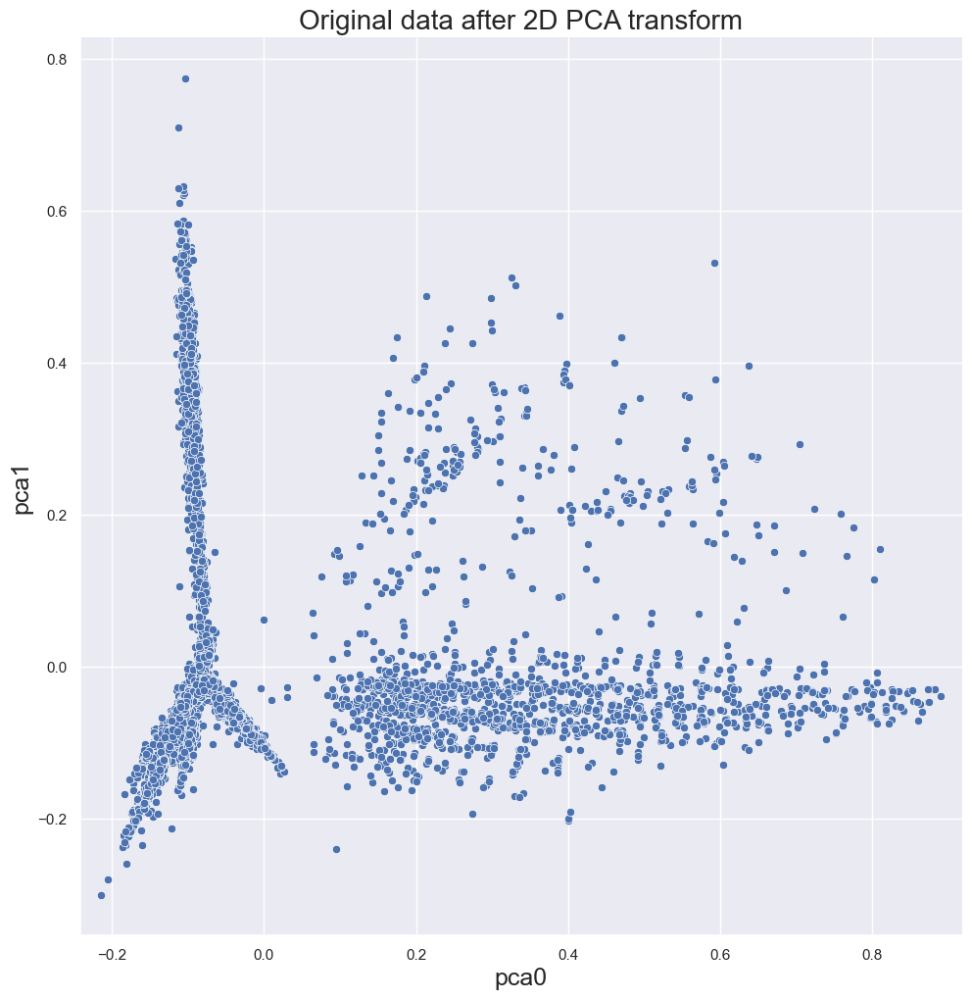

In [13]:
title = 'Original data after 2D PCA transform'
axes_PCA_2D = {'x': 'pca0', 'y': 'pca1'}
Plot2D (sample_PCA_2D, title, axes_PCA_2D)

#### Modelación vecinos cercanos

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


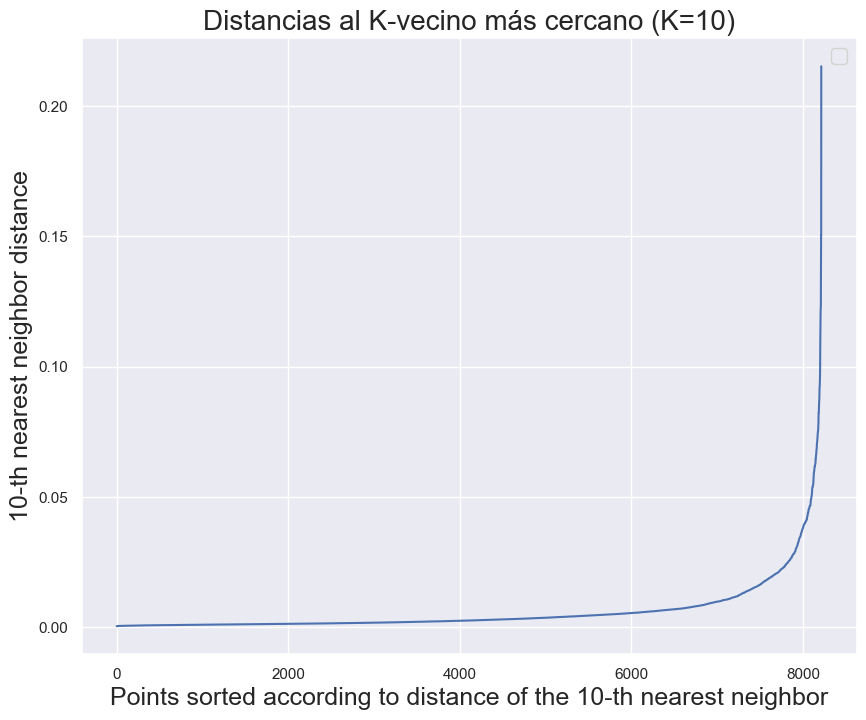

In [14]:
PlotDistancesToKnearestNeighbor(sample_PCA_2D, 10)

#### Aplicamos DBScan a los datos

In [15]:
min_samples = 10
epsilon_values = [0.028, 0.03, 0.032, 0.035 , 0.037, 0.04, 0.044, 0.046, 0.05, 0.06]
aux_labels = {}
for epsilon in epsilon_values:
  aux_labels[epsilon] = ApplyDBScanToData (sample_PCA_2D, epsilon, min_samples=min_samples)

epsilon = 0.046
labels_PCA_2D = aux_labels[epsilon]


Test for epsilon = 0.028
Estimated number of clusters: 5
Estimated number of noise points: 220
Silhouette Coefficient: 0.519

Test for epsilon = 0.03
Estimated number of clusters: 5
Estimated number of noise points: 199
Silhouette Coefficient: 0.518

Test for epsilon = 0.032
Estimated number of clusters: 5
Estimated number of noise points: 188
Silhouette Coefficient: 0.520

Test for epsilon = 0.035
Estimated number of clusters: 7
Estimated number of noise points: 148
Silhouette Coefficient: 0.394

Test for epsilon = 0.037
Estimated number of clusters: 8
Estimated number of noise points: 126
Silhouette Coefficient: 0.399

Test for epsilon = 0.04
Estimated number of clusters: 6
Estimated number of noise points: 109
Silhouette Coefficient: 0.413

Test for epsilon = 0.044
Estimated number of clusters: 6
Estimated number of noise points: 92
Silhouette Coefficient: 0.401

Test for epsilon = 0.046
Estimated number of clusters: 6
Estimated number of noise points: 72
Silhouette Coefficient: 0.

#### Representación del resultado

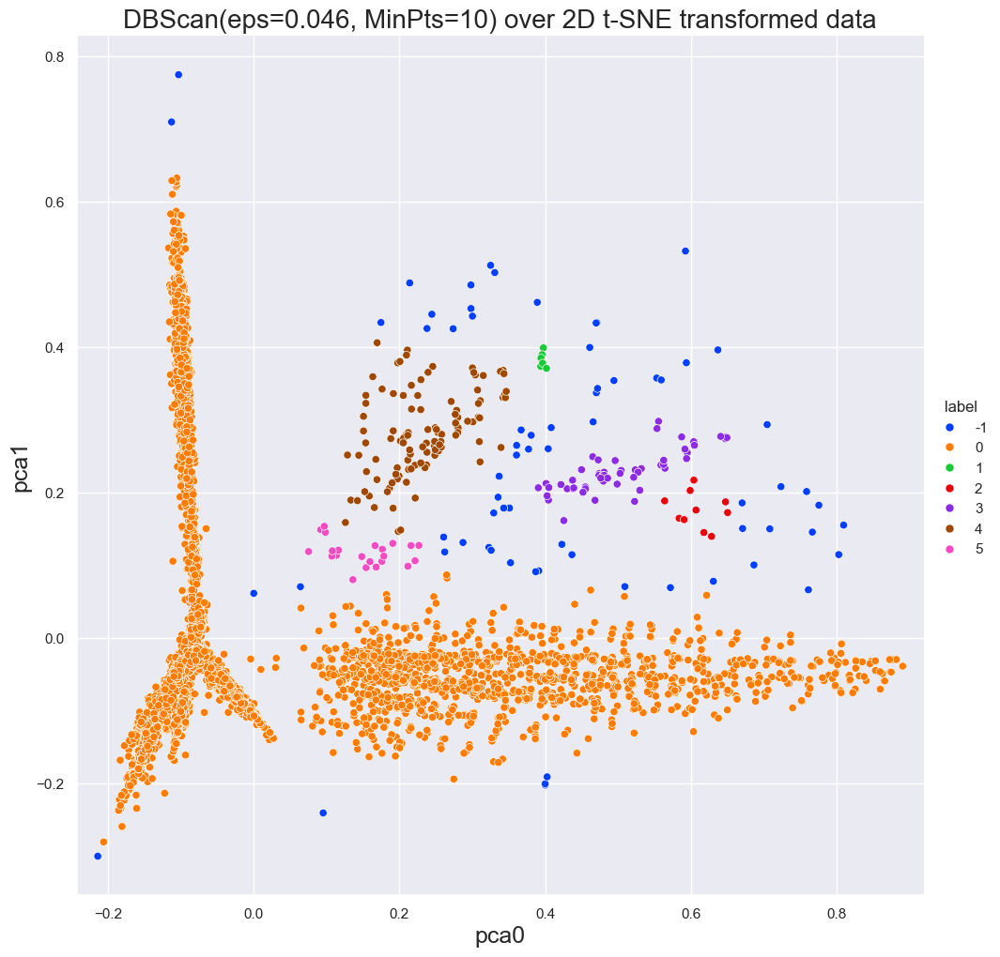

In [16]:
title = f'DBScan(eps={epsilon}, MinPts={min_samples}) over 2D t-SNE transformed data'
Plot2D_WithLabels (sample_PCA_2D, labels_PCA_2D, title, axes_PCA_2D)

#### Aplicación KMeans

In [17]:
#calculo kmeans del texto con aplicar PCA
clusters =[2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]
silhouette_avg = []


for i in clusters:
    km = KMeans(n_clusters=i, init='random', max_iter=200, random_state=0).fit(sample_PCA_2D)
    sample_km_pca_2d = km.labels_
    
    score = silhouette_score(sample_PCA_2D, km.labels_)
    silhouette_avg.append(score)
    
    print("cantidad de cluster:", i)
    print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(sample_PCA_2D, sample_km_pca_2d))

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 2
Silhouette Coefficient: 0.626


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 3
Silhouette Coefficient: 0.712


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 4
Silhouette Coefficient: 0.702


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 5
Silhouette Coefficient: 0.505


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 6
Silhouette Coefficient: 0.522


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 7
Silhouette Coefficient: 0.463


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 8
Silhouette Coefficient: 0.516


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 9
Silhouette Coefficient: 0.509


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 10
Silhouette Coefficient: 0.455


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 11
Silhouette Coefficient: 0.499


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 12
Silhouette Coefficient: 0.509


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 13
Silhouette Coefficient: 0.504


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 14
Silhouette Coefficient: 0.493


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 15
Silhouette Coefficient: 0.505


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 16
Silhouette Coefficient: 0.502


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 17
Silhouette Coefficient: 0.475


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 18
Silhouette Coefficient: 0.492


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 19
Silhouette Coefficient: 0.500


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 20
Silhouette Coefficient: 0.477


#### Gráfico K-Means 

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\kevin\AppData\Local\Temp\ipykernel_10472\1159395536.py:76: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ax.text(row[0]+.5, row[1], 'C'+str(row[2].astype(int)), fontsize = 20, color='black', weight='semibold')


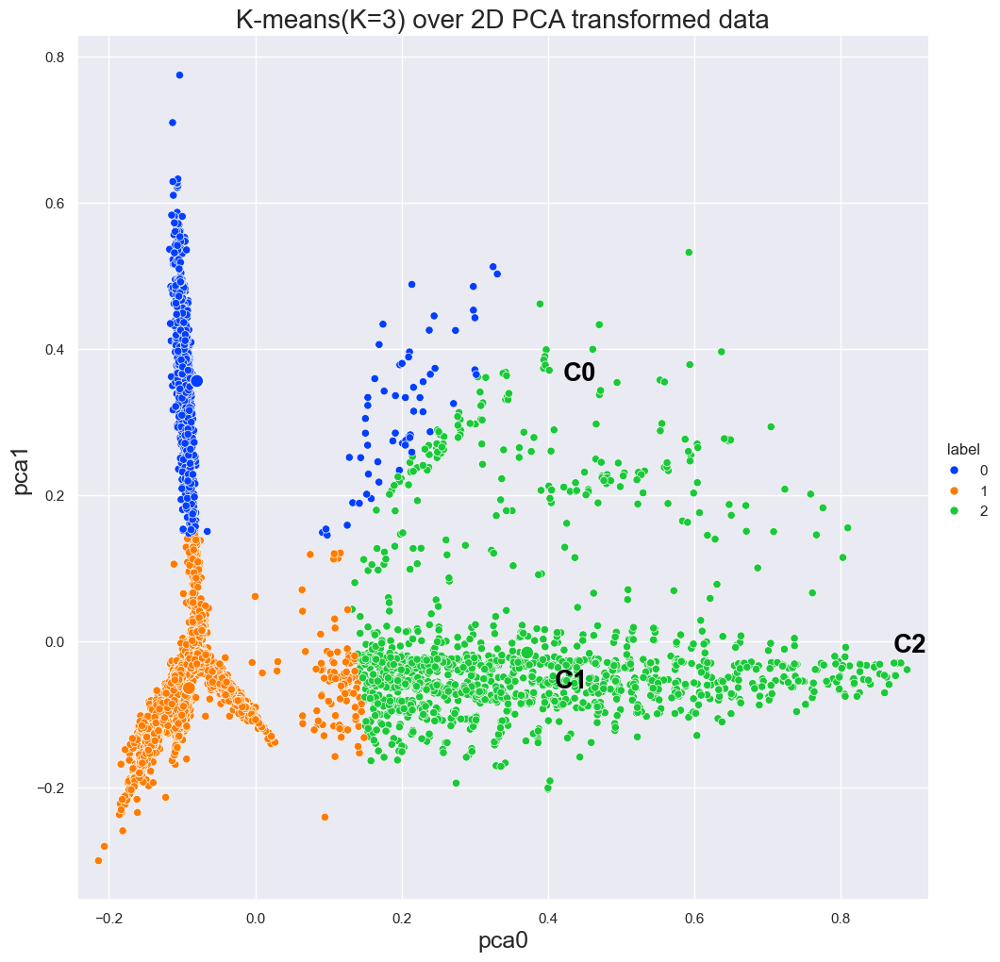

In [18]:
n_clusters = clusters[pd.Series(silhouette_avg).idxmax()]
kmeans = KMeans(n_clusters=n_clusters)
label = kmeans.fit_predict(sample_PCA_2D)

axes_PCA = {'x': 'pca0', 'y': 'pca1'}
title = f'K-means(K={n_clusters}) over 2D PCA transformed data'
plot = Plot2D_WithLabels(sample_PCA_2D, kmeans.labels_, title, axes_PCA, centroids_2D=kmeans.cluster_centers_)

### Aplicación TSNE 2D

#### Creación del modelo

In [19]:
tsne2D = TSNE(n_components=2)
samples_TSNE_2D = tsne2D.fit_transform(samples)
df_samples_TSNE_2D = pd.DataFrame(data=samples_TSNE_2D, columns=["tsne0", "tsne1"])

#### Representación Visual

C:\Users\kevin\AppData\Local\Temp\ipykernel_10472\1159395536.py:17: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.relplot(data=df_samples_2D,


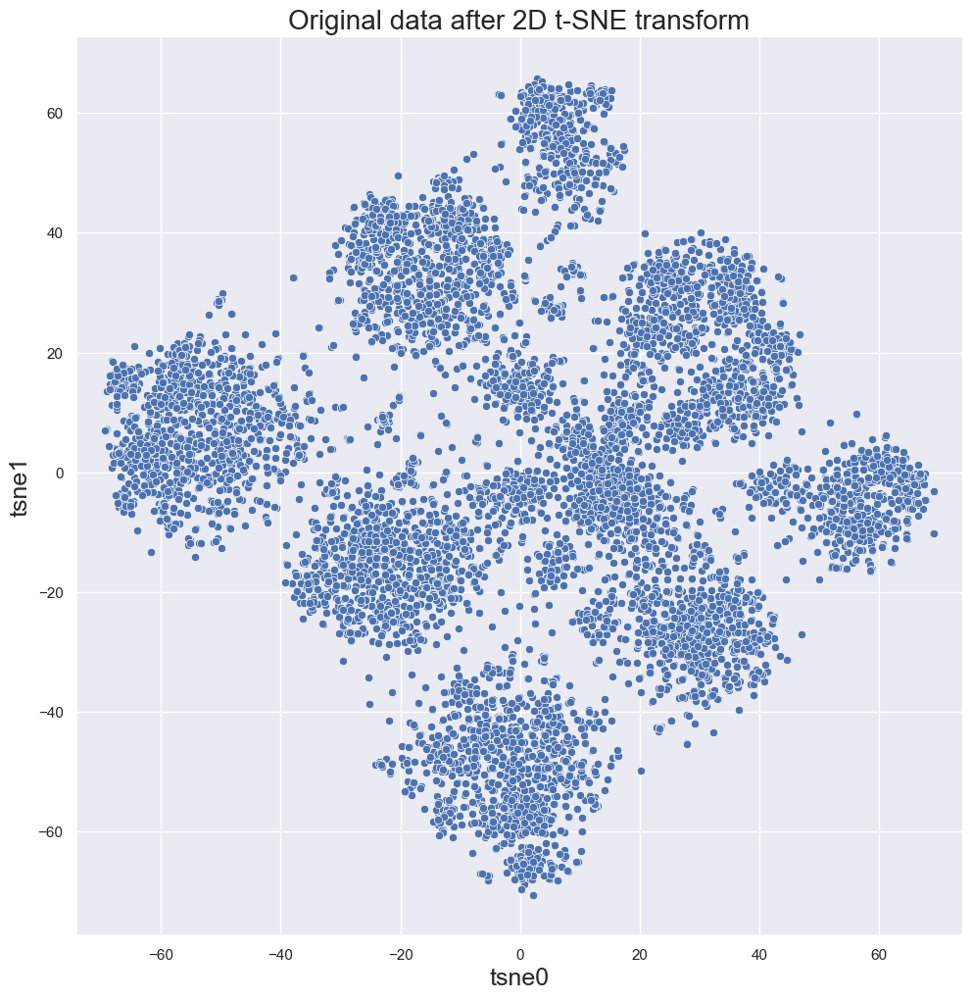

In [20]:
title = 'Original data after 2D t-SNE transform'
axes_TSNE_2D = {'x': 'tsne0', 'y': 'tsne1'}
Plot2D (samples_TSNE_2D, title, axes_TSNE_2D)

#### Modelación KnearestNeighbor TSNE 2D

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


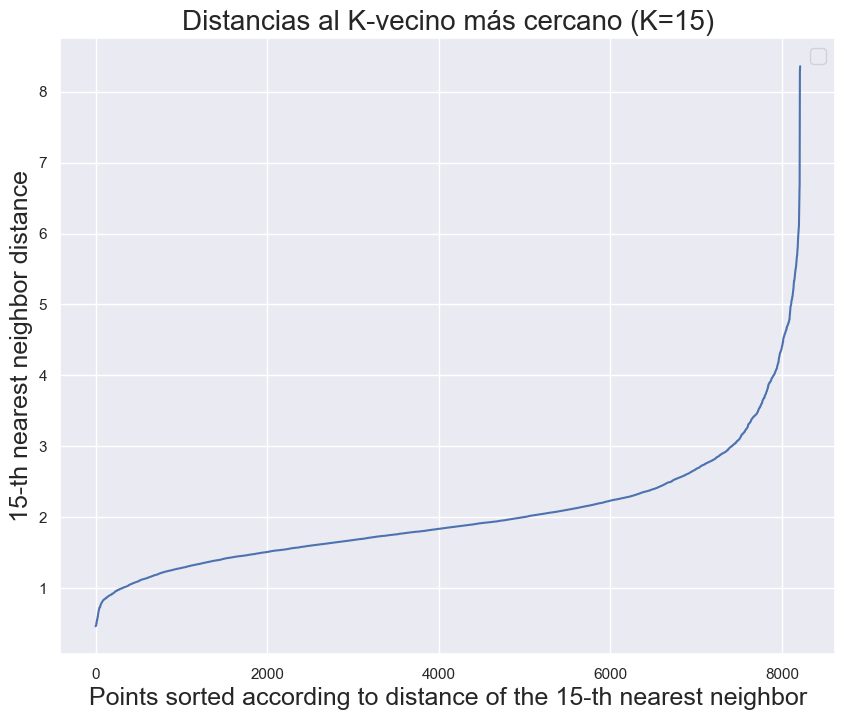

In [21]:
PlotDistancesToKnearestNeighbor(samples_TSNE_2D, 15)

#### Aplicación KMeans

In [22]:
#calculo kmeans del texto con aplicar PCA
clusters =[2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]
silhouette_avg = []


for i in clusters:
    km = KMeans(n_clusters=i, init='random', max_iter=200, random_state=0).fit(samples_TSNE_2D)
    sample_km_pca_2d = km.labels_
    
    score = silhouette_score(samples_TSNE_2D, km.labels_)
    silhouette_avg.append(score)
    
    print("cantidad de cluster:", i)
    print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(samples_TSNE_2D, sample_km_pca_2d))

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 2
Silhouette Coefficient: 0.370


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 3
Silhouette Coefficient: 0.384


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 4
Silhouette Coefficient: 0.418


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 5
Silhouette Coefficient: 0.440


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 6
Silhouette Coefficient: 0.462


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 7
Silhouette Coefficient: 0.485


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 8
Silhouette Coefficient: 0.504


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 9
Silhouette Coefficient: 0.518


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 10
Silhouette Coefficient: 0.512


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 11
Silhouette Coefficient: 0.482


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 12
Silhouette Coefficient: 0.466


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 13
Silhouette Coefficient: 0.456


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 14
Silhouette Coefficient: 0.423


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 15
Silhouette Coefficient: 0.414


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 16
Silhouette Coefficient: 0.399


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 17
Silhouette Coefficient: 0.409


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 18
Silhouette Coefficient: 0.412


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 19
Silhouette Coefficient: 0.400


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 20
Silhouette Coefficient: 0.406


#### Gráfico K-Means

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\kevin\AppData\Local\Temp\ipykernel_10472\1159395536.py:76: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ax.text(row[0]+.5, row[1], 'C'+str(row[2].astype(int)), fontsize = 20, color='black', weight='semibold')


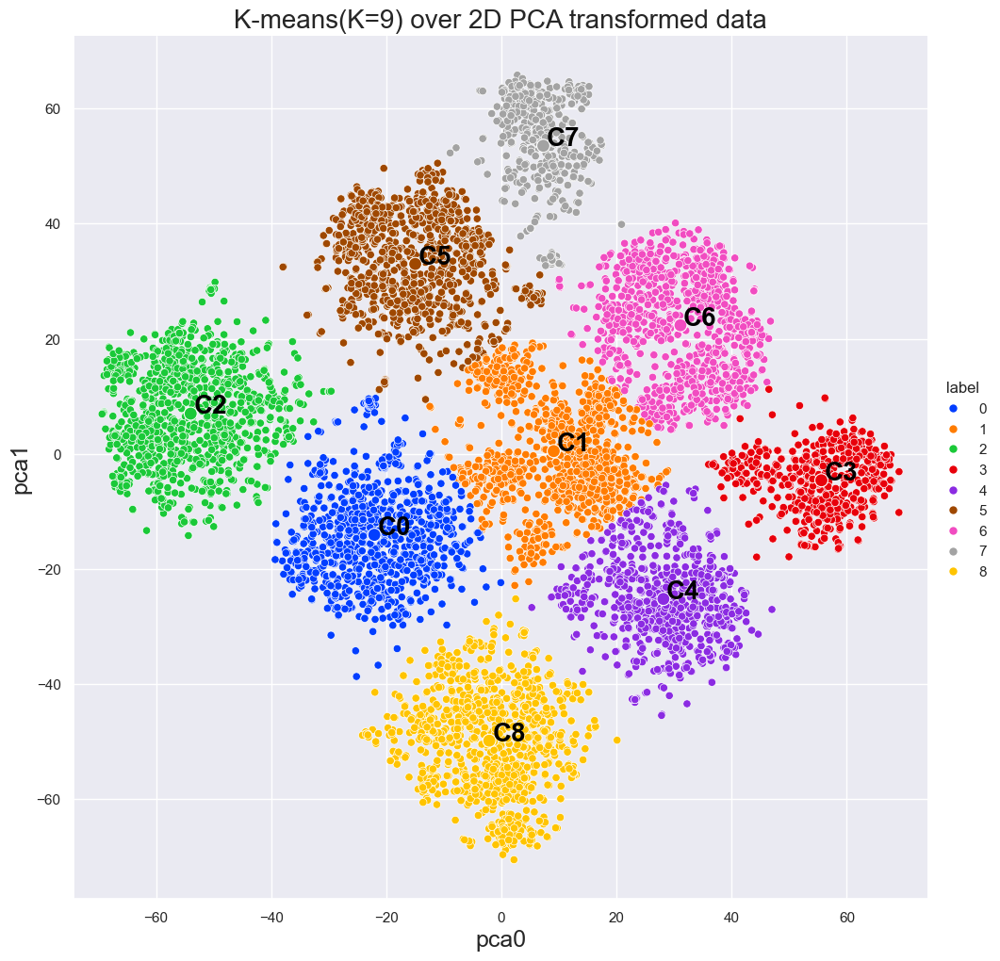

In [23]:
n_clusters = clusters[pd.Series(silhouette_avg).idxmax()]
kmeans = KMeans(n_clusters=n_clusters)
label = kmeans.fit_predict(samples_TSNE_2D)

axes_PCA = {'x': 'pca0', 'y': 'pca1'}
title = f'K-means(K={n_clusters}) over 2D PCA transformed data'
plot = Plot2D_WithLabels(samples_TSNE_2D, kmeans.labels_, title, axes_PCA, centroids_2D=kmeans.cluster_centers_)

#### Aplicación DBScan

In [24]:
min_samples = 20
epsilon_values = [3.2, 3.4, 3.6, 3.8, 3.9, 4, 4.05, 4.055,4.1, 4.3, 4.5, 4.7, 4.9]
aux_labels = {}
for epsilon in epsilon_values:
  aux_labels[epsilon] = ApplyDBScanToData (samples_TSNE_2D, epsilon, min_samples=min_samples)

epsilon = 3.4
labels_TSNE_2D = aux_labels[epsilon]


Test for epsilon = 3.2
Estimated number of clusters: 11
Estimated number of noise points: 326
Silhouette Coefficient: 0.065

Test for epsilon = 3.4
Estimated number of clusters: 7
Estimated number of noise points: 248
Silhouette Coefficient: 0.039

Test for epsilon = 3.6
Estimated number of clusters: 6
Estimated number of noise points: 194
Silhouette Coefficient: 0.092

Test for epsilon = 3.8
Estimated number of clusters: 7
Estimated number of noise points: 129
Silhouette Coefficient: 0.064

Test for epsilon = 3.9
Estimated number of clusters: 7
Estimated number of noise points: 105
Silhouette Coefficient: 0.067

Test for epsilon = 4
Estimated number of clusters: 7
Estimated number of noise points: 97
Silhouette Coefficient: 0.068

Test for epsilon = 4.05
Estimated number of clusters: 7
Estimated number of noise points: 90
Silhouette Coefficient: 0.069

Test for epsilon = 4.055
Estimated number of clusters: 7
Estimated number of noise points: 90
Silhouette Coefficient: 0.069

Test for

#### Representación del resultado

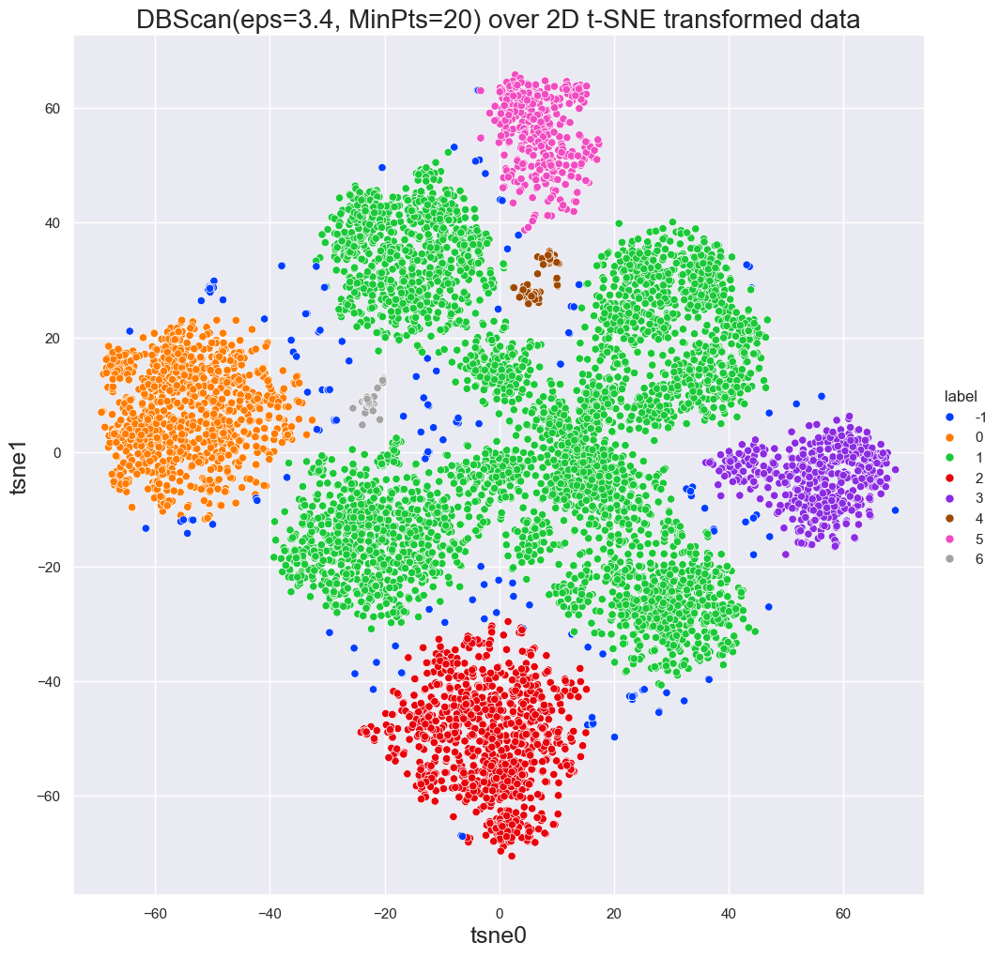

In [25]:
title = f'DBScan(eps={epsilon}, MinPts={min_samples}) over 2D t-SNE transformed data'
Plot2D_WithLabels (samples_TSNE_2D, labels_TSNE_2D, title, axes_TSNE_2D)

# Embedding BETO - MARIA

## Dataset BETO

### Cargado de Datos

In [26]:
dataset2 = np.loadtxt("EmoEvalEs-embeddings-BETO.txt")
dataset2.shape

(8223, 768)

### Nearest Neighbor

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


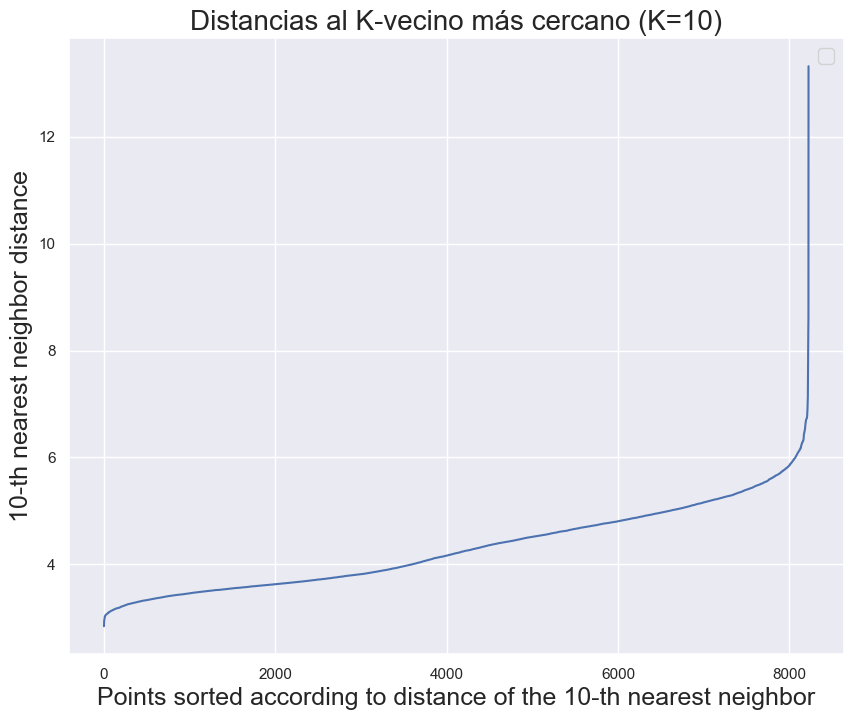

In [27]:
PlotDistancesToKnearestNeighbor(dataset2, 10)

### DBScan sin Reducción de Dimensionalidad

In [28]:
min_samples = 10
epsilon_values = [4,4.1,4.2,4.3,4.4,4.5,4.6,4.7,4.8,5,6]
aux_labels = {}
for epsilon in epsilon_values:
  aux_labels[epsilon] = ApplyDBScanToData(dataset2, epsilon, min_samples=min_samples)

epsilon = 4.3
labels = aux_labels[epsilon]


Test for epsilon = 4
Estimated number of clusters: 3
Estimated number of noise points: 4069
Silhouette Coefficient: 0.047

Test for epsilon = 4.1
Estimated number of clusters: 3
Estimated number of noise points: 3718
Silhouette Coefficient: 0.040

Test for epsilon = 4.2
Estimated number of clusters: 1
Estimated number of noise points: 3377
Silhouette Coefficient: 0.121

Test for epsilon = 4.3
Estimated number of clusters: 2
Estimated number of noise points: 2995
Silhouette Coefficient: 0.092

Test for epsilon = 4.4
Estimated number of clusters: 2
Estimated number of noise points: 2618
Silhouette Coefficient: 0.049

Test for epsilon = 4.5
Estimated number of clusters: 1
Estimated number of noise points: 2234
Silhouette Coefficient: 0.119

Test for epsilon = 4.6
Estimated number of clusters: 1
Estimated number of noise points: 1881
Silhouette Coefficient: 0.122

Test for epsilon = 4.7
Estimated number of clusters: 1
Estimated number of noise points: 1584
Silhouette Coefficient: 0.127

T

### K-Means sin PCA

In [29]:
for i in range(2,20):
    km = KMeans(n_clusters=i, init='random', max_iter=200, random_state=0).fit(dataset2)
    sample_km = km.labels_
    score = metrics.silhouette_score(dataset2, sample_km)
    print("cantidad de cluster:", i)
    print("Silhouette Coefficient: %0.3f" % score)

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 2
Silhouette Coefficient: 0.148


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 3
Silhouette Coefficient: 0.152


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 4
Silhouette Coefficient: 0.141


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 5
Silhouette Coefficient: 0.050


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 6
Silhouette Coefficient: 0.055


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 7
Silhouette Coefficient: 0.054


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 8
Silhouette Coefficient: 0.057


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 9
Silhouette Coefficient: 0.059


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 10
Silhouette Coefficient: 0.041


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 11
Silhouette Coefficient: 0.053


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 12
Silhouette Coefficient: 0.046


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 13
Silhouette Coefficient: 0.046


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 14
Silhouette Coefficient: 0.046


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 15
Silhouette Coefficient: 0.048


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 16
Silhouette Coefficient: 0.038


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 17
Silhouette Coefficient: 0.038


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 18
Silhouette Coefficient: 0.040


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


cantidad de cluster: 19
Silhouette Coefficient: 0.041


### PCA 2D

#### Búsqueda N° óptimo CLusters

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


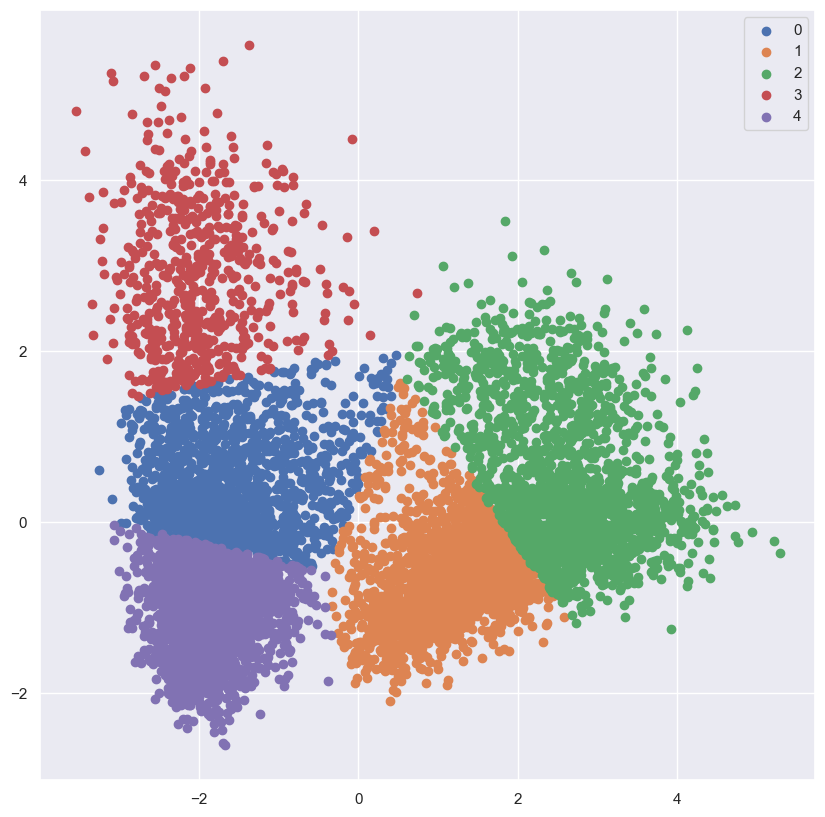

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


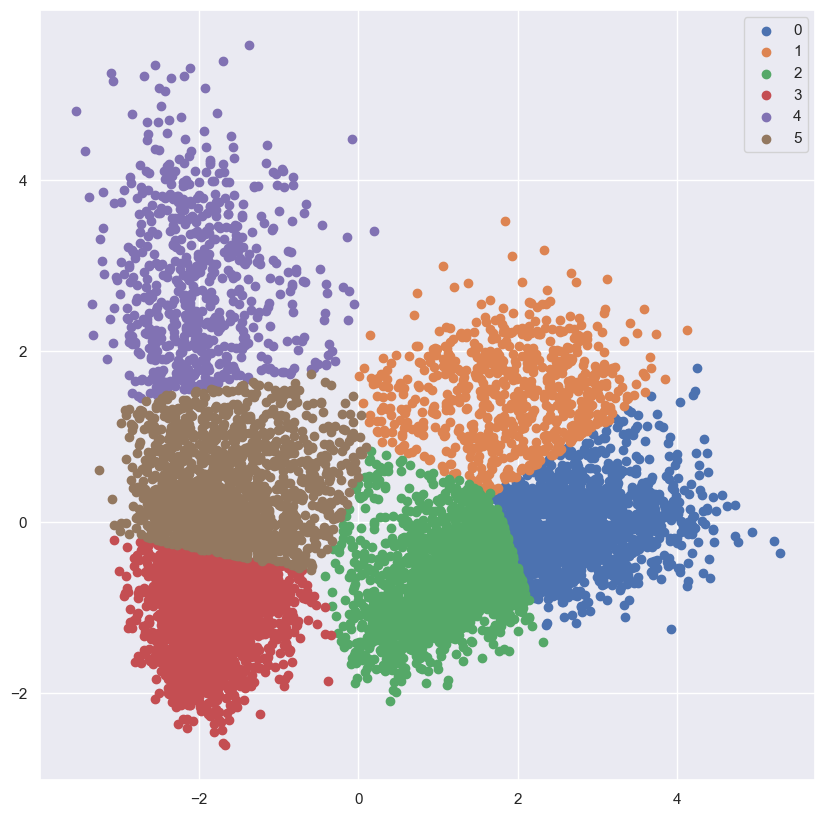

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


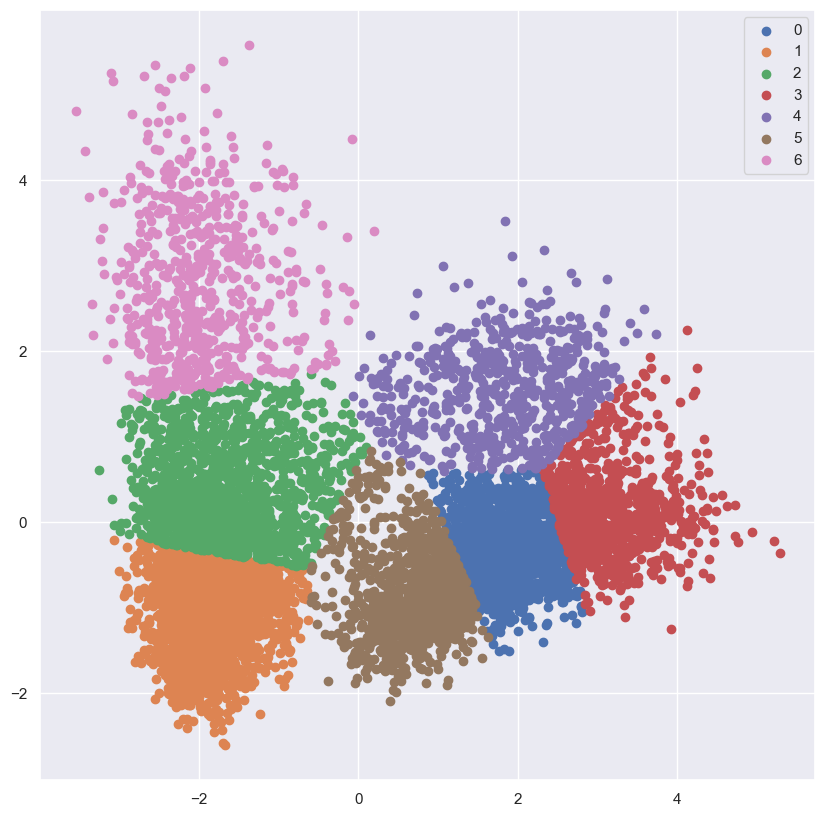

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


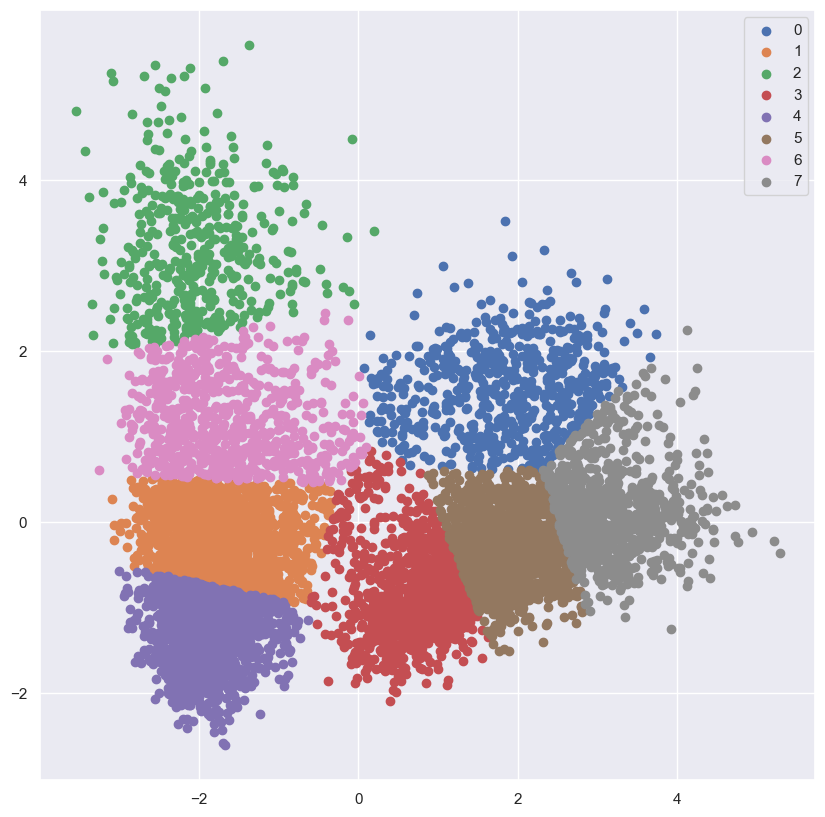

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


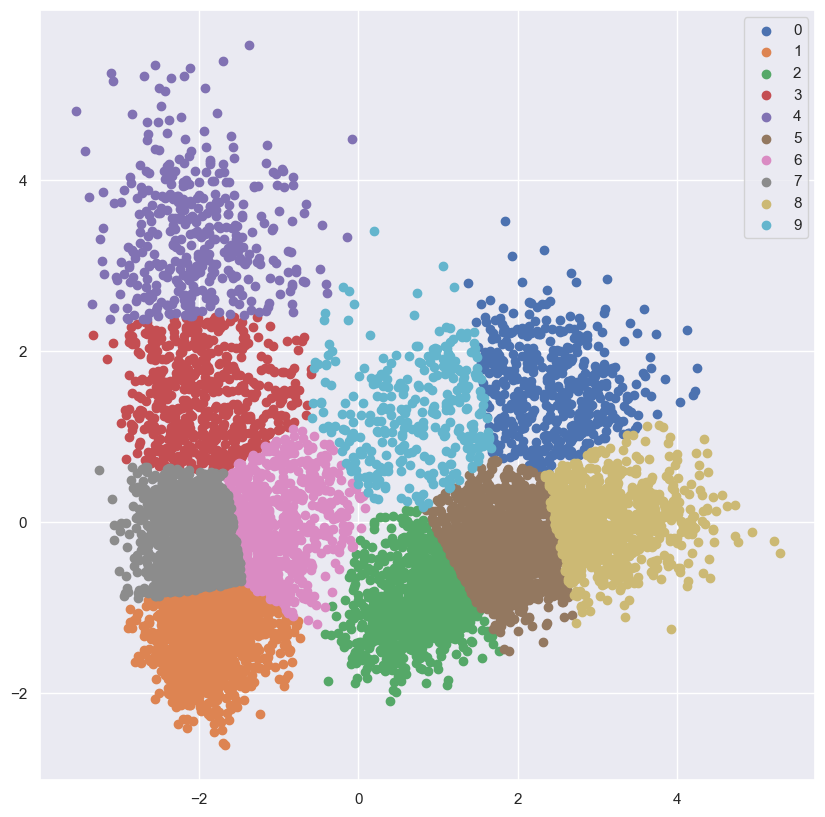

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


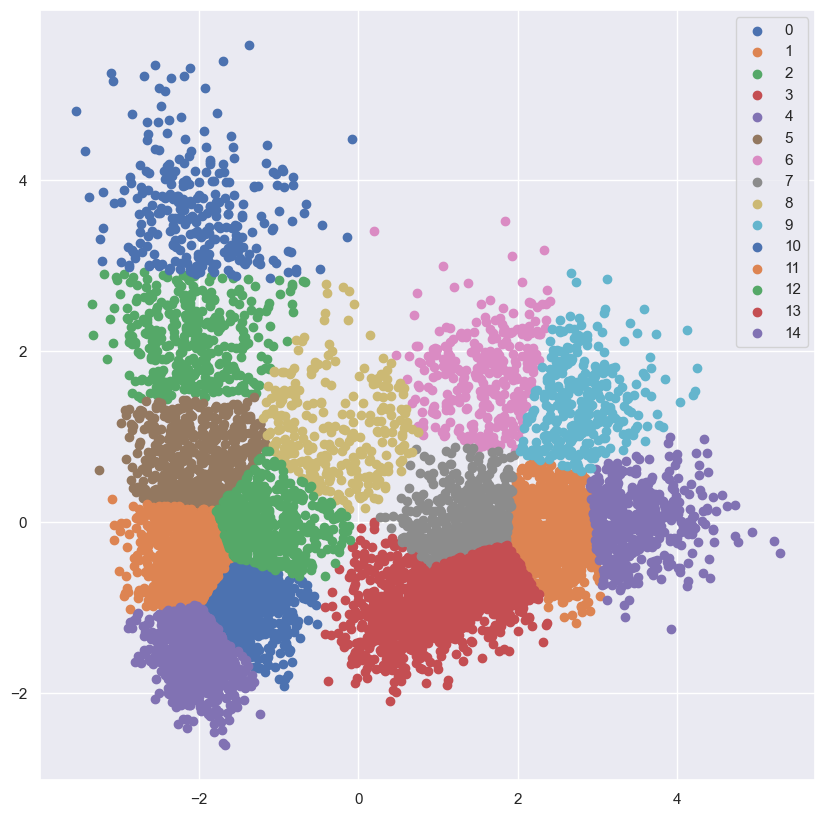

In [30]:
# Raw Data
pca2D = PCA(2)
 
#Transform the data
df_2D = pca2D.fit_transform(dataset2)

df_samples_PCA_2D = pd.DataFrame(data=df_2D, columns=["pca0", "pca1"])

clusters = [5,6,7,8,10,15]
silhouette_avg = []

for i in clusters:
    #Initialize the class object
    kmeans = KMeans(n_clusters=i)
     
    #predict the labels of clusters.
    label = kmeans.fit_predict(df_samples_PCA_2D)
     
    #Getting unique labels
    u_labels = np.unique(label)
     
    #plotting the results:
    for i in u_labels:
        plt.scatter(df_2D[label == i , 0] , df_2D[label == i , 1] , label = i)
    plt.legend()
    plt.show()
    
    score = silhouette_score(df_samples_PCA_2D, kmeans.labels_)
    silhouette_avg.append(score)

#### Modelacion N° clusters - Score Silhouette

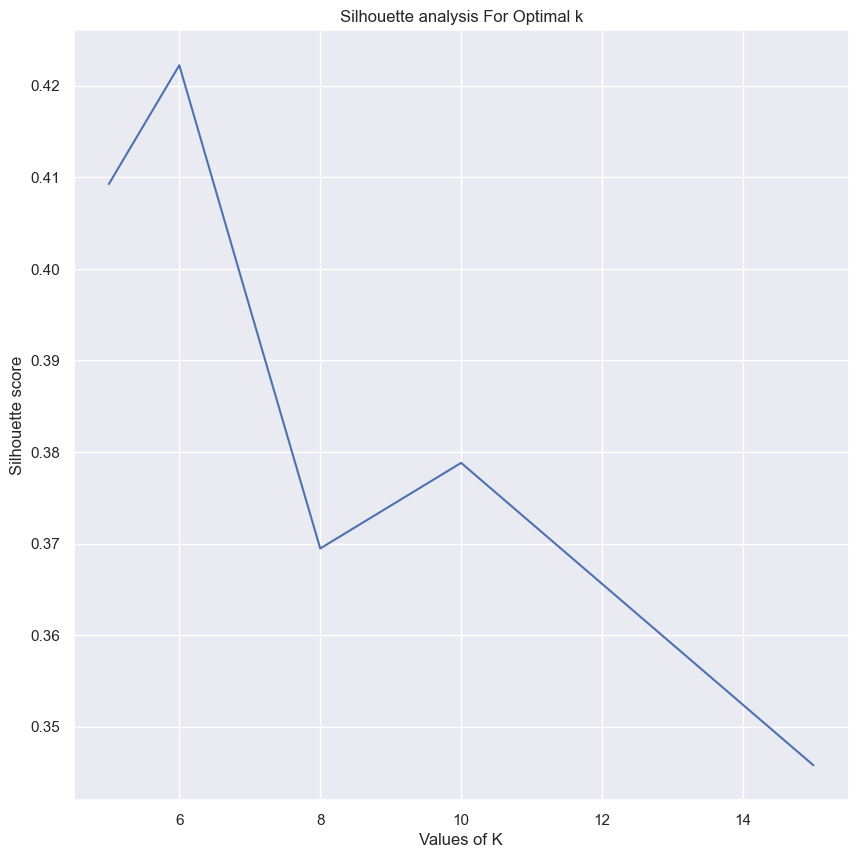

N° Clusters con mejor Score:  6 
Score:  0.42224434555069185


In [31]:
plt.plot(clusters,silhouette_avg)
plt.xlabel("Values of K") 
plt.ylabel("Silhouette score") 
plt.title("Silhouette analysis For Optimal k")
plt.show()
print("N° Clusters con mejor Score: ",clusters[pd.Series(silhouette_avg).idxmax()],"\nScore: ",max(silhouette_avg))

#### Modelado K-Means con N° Óptimo Clusters 2D

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\kevin\AppData\Local\Temp\ipykernel_10472\1159395536.py:76: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ax.text(row[0]+.5, row[1], 'C'+str(row[2].astype(int)), fontsize = 20, color='black', weight='semibold')


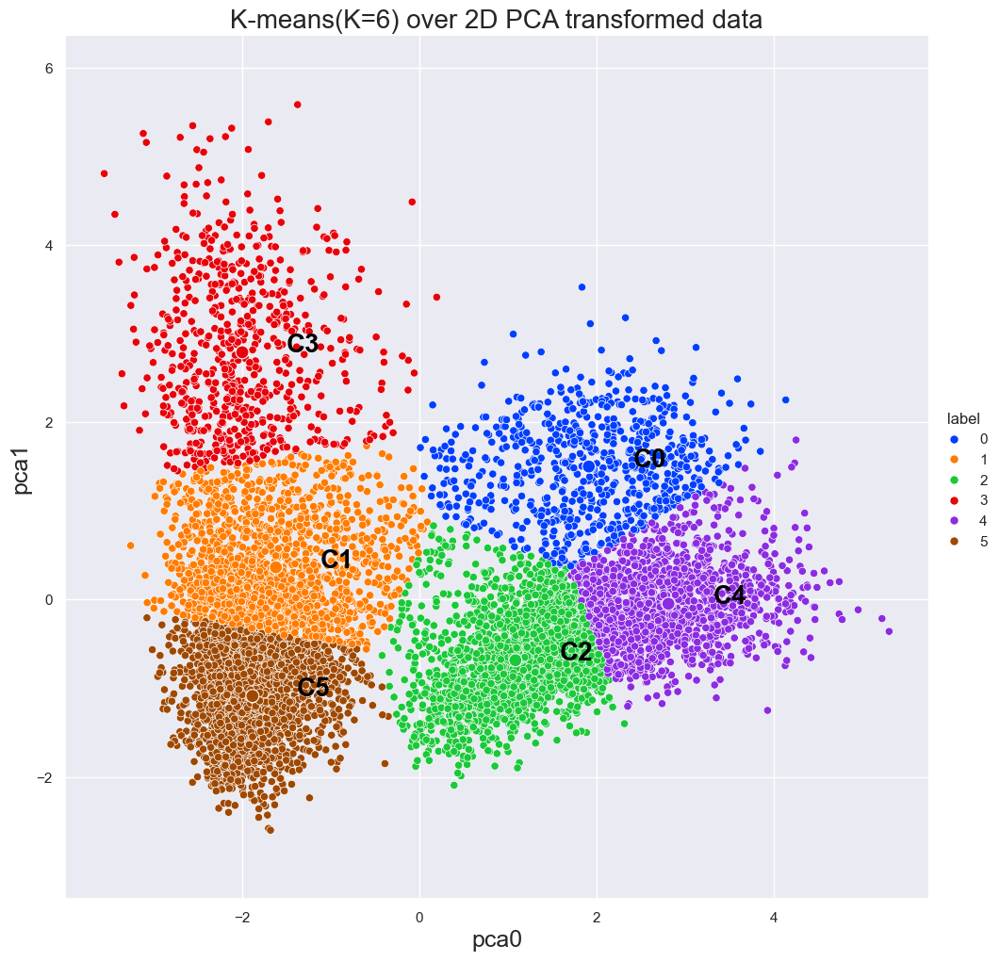

In [32]:
n_clusters = clusters[pd.Series(silhouette_avg).idxmax()]
kmeans = KMeans(n_clusters=n_clusters)
label = kmeans.fit_predict(df_samples_PCA_2D)

axes_PCA = {'x': 'pca0', 'y': 'pca1'}
title = f'K-means(K={n_clusters}) over 2D PCA transformed data'
plot = Plot2D_WithLabels(df_samples_PCA_2D, kmeans.labels_, title, axes_PCA, centroids_2D=kmeans.cluster_centers_)

### PCA 3D

#### Búsqueda N° óptimo Clusters

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


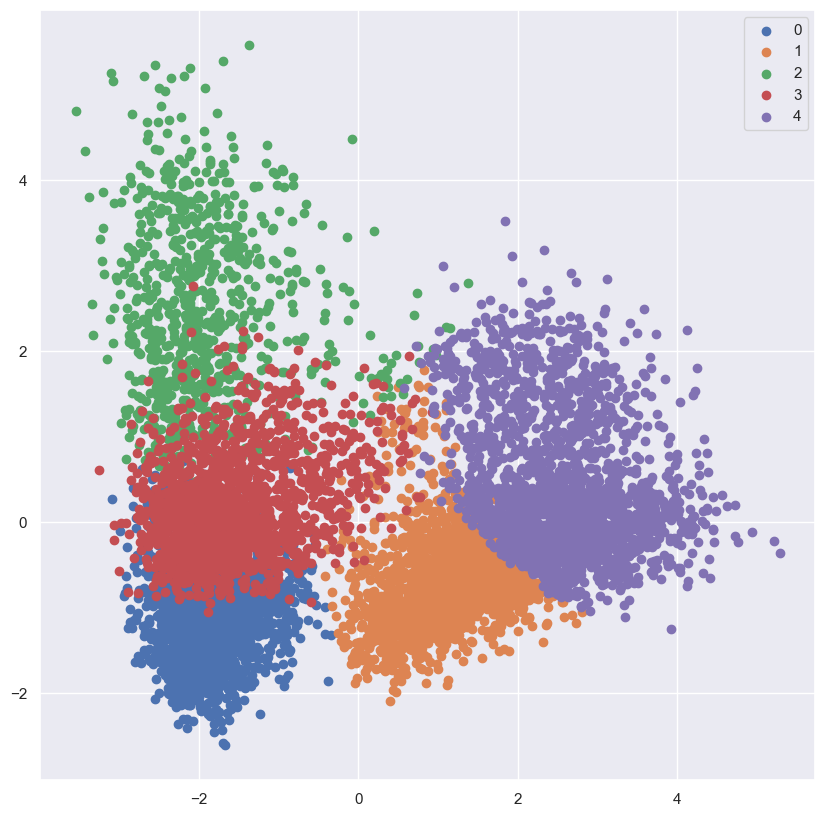

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


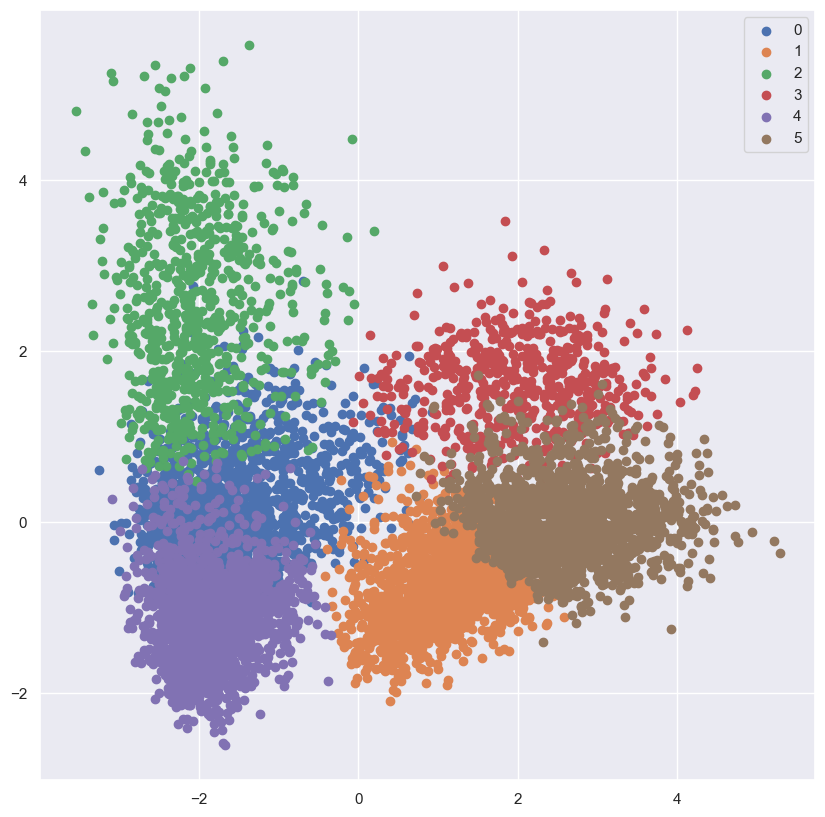

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


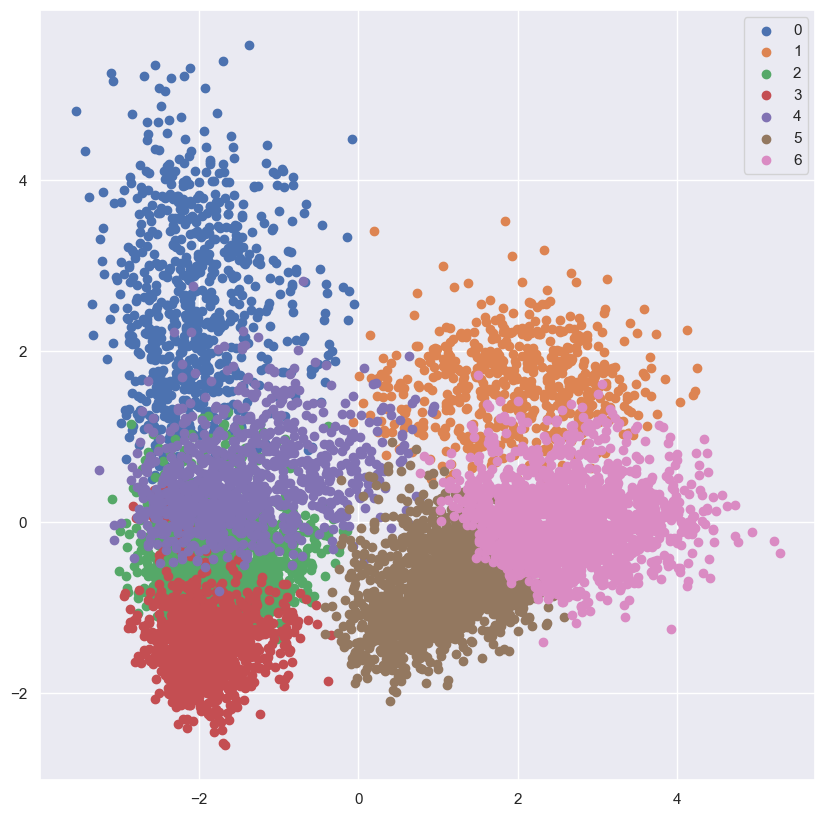

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


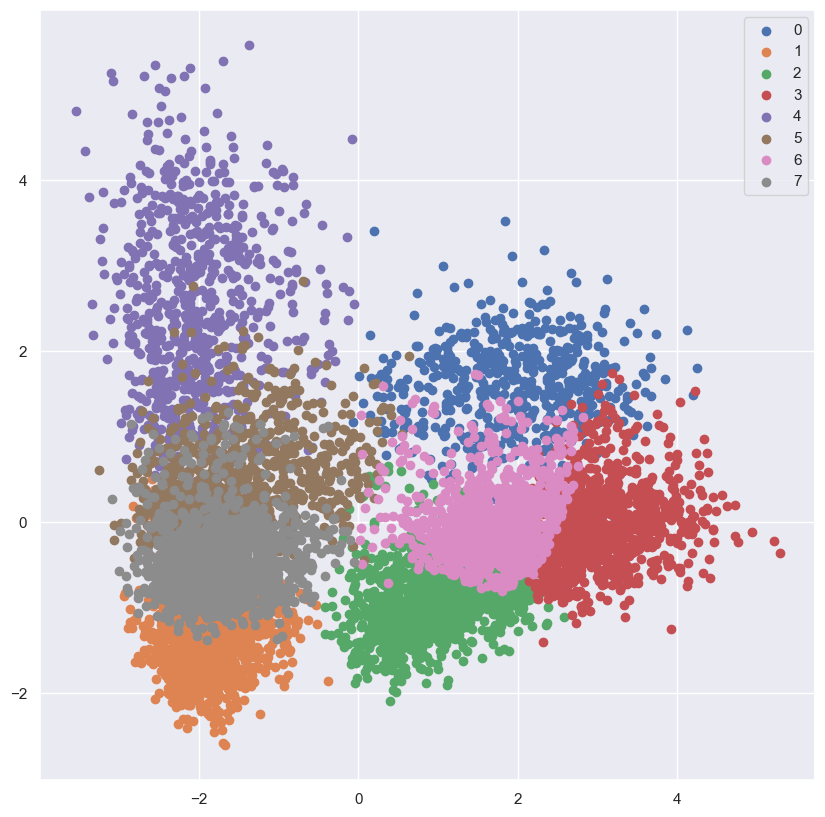

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


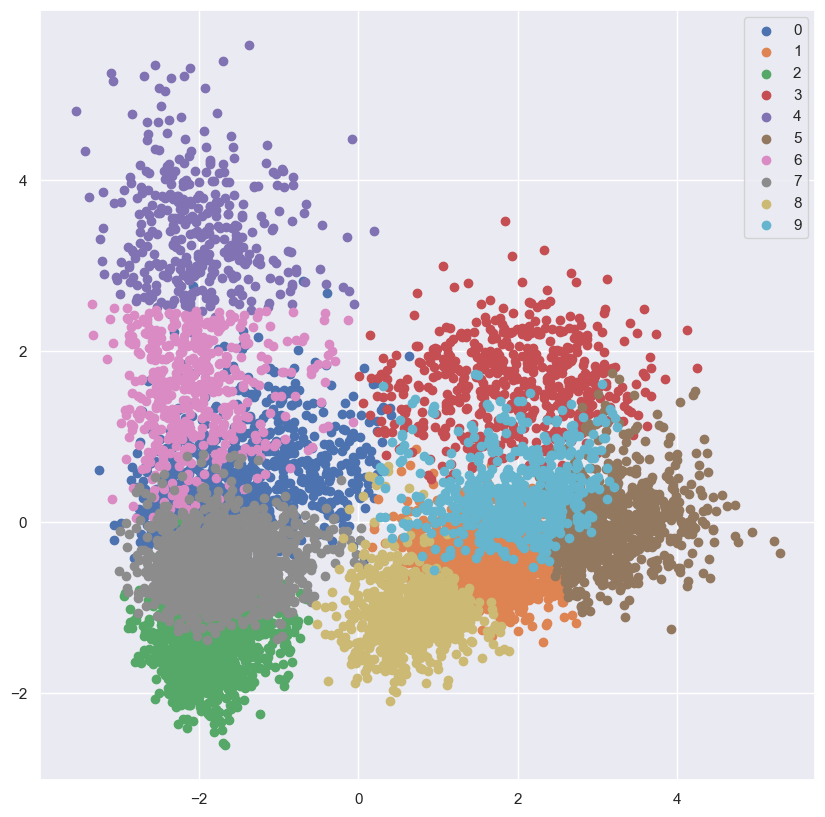

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


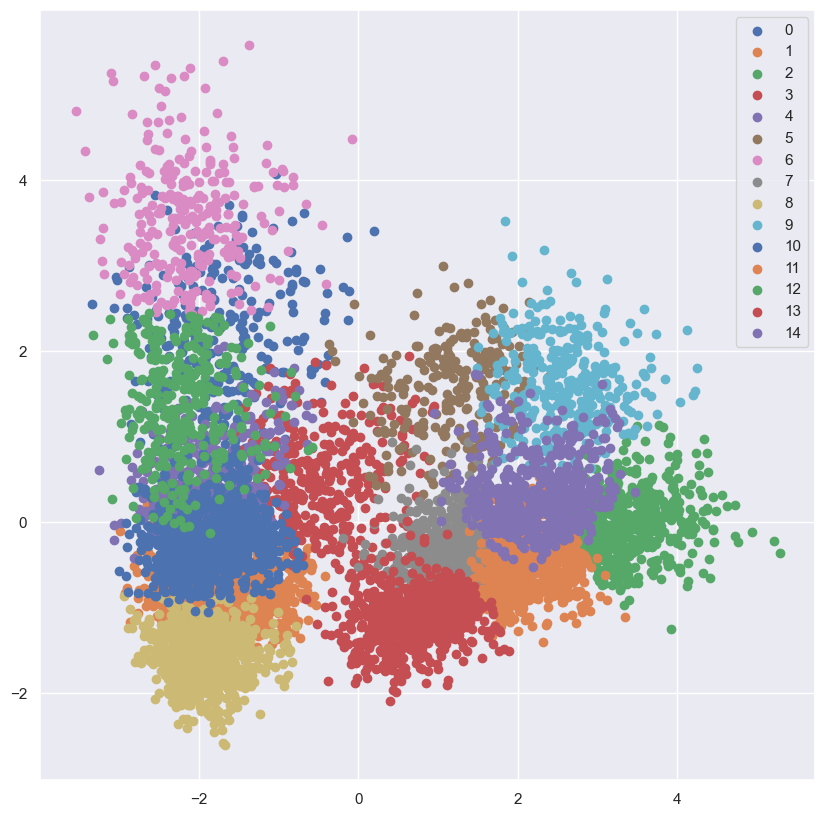

In [33]:
pca3D = PCA(n_components=3)
df_3D = pca3D.fit_transform(dataset2)
df_samples_PCA_3D = pd.DataFrame(data=df_3D, columns=["pca0", "pca1", "pca2"])

clusters = [5,6,7,8,10,15]
silhouette_avg = []

for i in clusters:
    #Initialize the class object
    kmeans = KMeans(n_clusters=i)
     
    #predict the labels of clusters.
    label = kmeans.fit_predict(df_samples_PCA_3D)
     
    #Getting unique labels
    u_labels = np.unique(label)
     
    #plotting the results:
    for i in u_labels:
        plt.scatter(df_3D[label == i , 0] , df_3D[label == i , 1] , label = i)
    plt.legend()
    plt.show()
    
    score = silhouette_score(df_samples_PCA_3D, kmeans.labels_)
    silhouette_avg.append(score)

#### Modelacion N° clusters - Score Silhouette

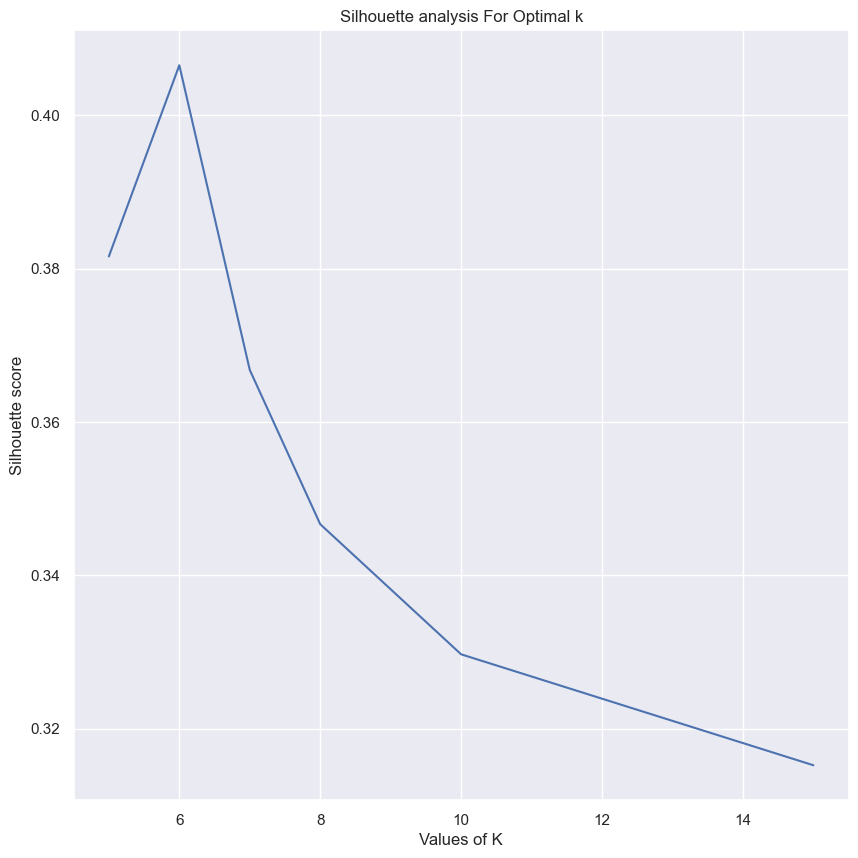

N° Clusters con mejor Score:  6 
Score:  0.40655595662968547


In [34]:
plt.plot(clusters,silhouette_avg)
plt.xlabel("Values of K") 
plt.ylabel("Silhouette score") 
plt.title("Silhouette analysis For Optimal k")
plt.show()
print("N° Clusters con mejor Score: ",clusters[pd.Series(silhouette_avg).idxmax()],"\nScore: ",max(silhouette_avg))

#### Modelado K-Means con N° Óptimo Clusters 3D

In [35]:
n_clusters = clusters[pd.Series(silhouette_avg).idxmax()]
kmeans = KMeans(n_clusters=n_clusters)
label = kmeans.fit_predict(df_samples_PCA_3D)
axes_PCA_3D = {'x': 'pca0', 'y': 'pca1', 'z': 'pca2'}

title = f'K-means(K={n_clusters}) over 3D PCA transformed data'
plot = Plot3D_WithLabels (df_samples_PCA_3D, kmeans.labels_, title, axes_PCA_3D, centroids_3D=kmeans.cluster_centers_)

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


### t-SNE 2D

#### Reducción de Dimensión

In [36]:
tsne2D = TSNE(n_components=2)
samples_TSNE_2D = tsne2D.fit_transform(dataset2)
df_samples_TSNE_2D = pd.DataFrame(data=samples_TSNE_2D, columns=["tsne0", "tsne1"])

#### Visualización t-SNE 2D

C:\Users\kevin\AppData\Local\Temp\ipykernel_10472\1159395536.py:17: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



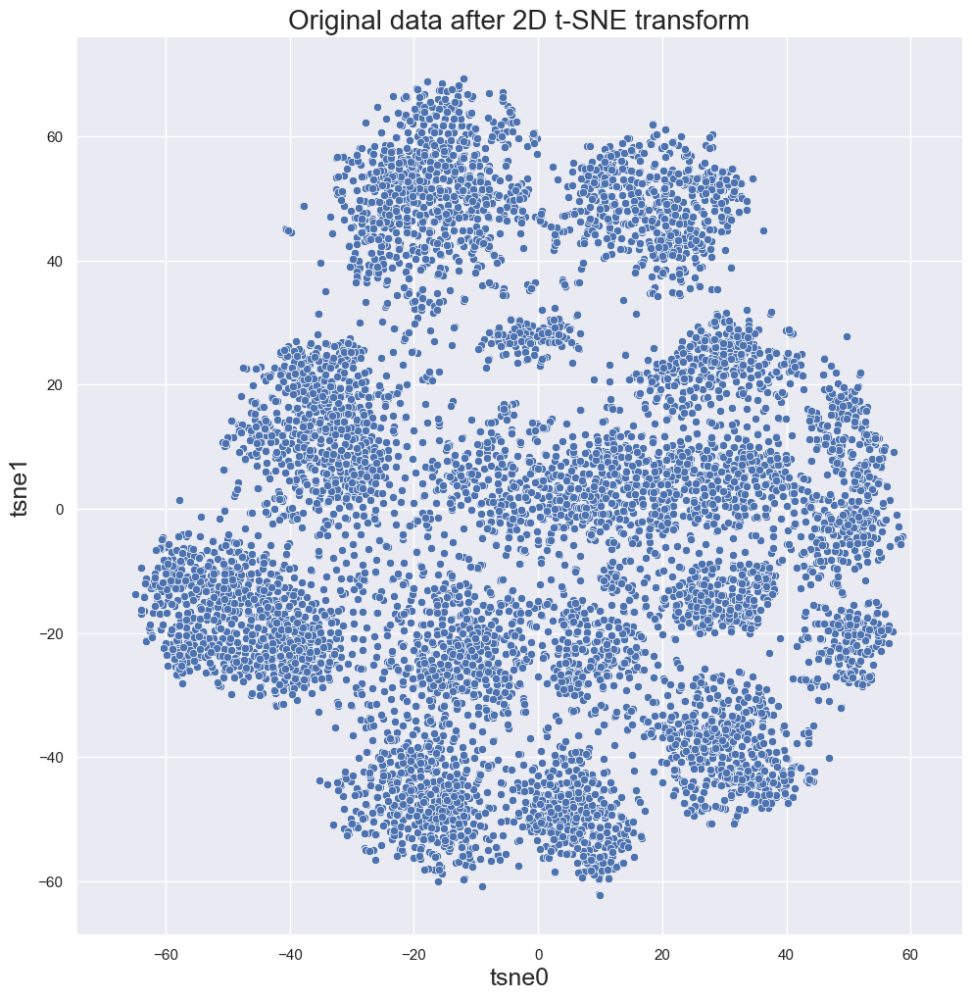

In [37]:
title = 'Original data after 2D t-SNE transform'
axes_TSNE_2D = {'x': 'tsne0', 'y': 'tsne1'}
Plot2D (samples_TSNE_2D, title, axes_TSNE_2D)

#### DBScan t-SNE 2D

##### Modelación Nearest Neighbor

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


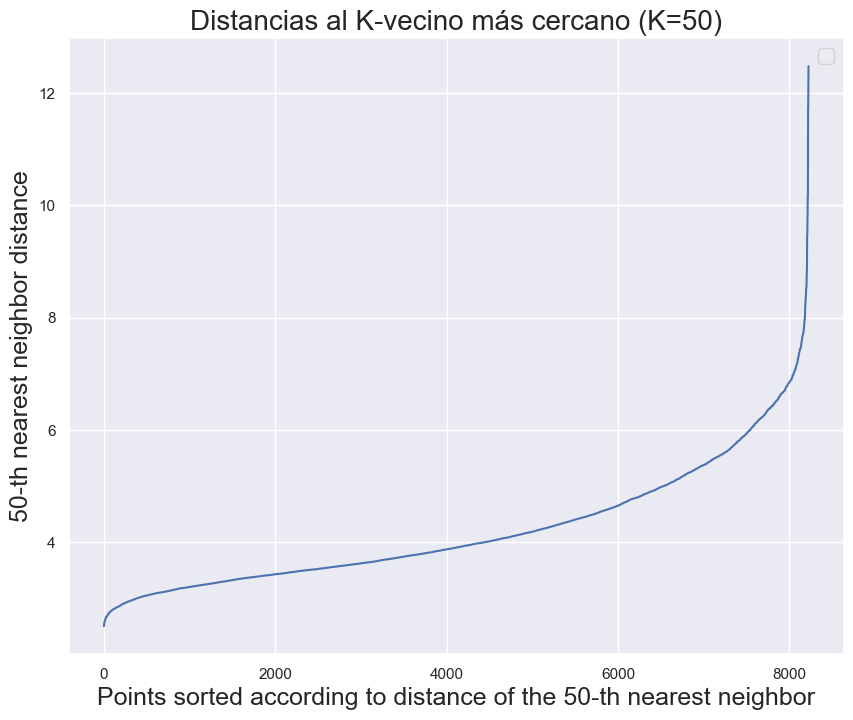

In [38]:
PlotDistancesToKnearestNeighbor(samples_TSNE_2D, 50) # notese que el parametro de entrada NO es samples

##### Epsilons Score Silhouette 

In [39]:
min_samples = 50
epsilon_values = [3.9, 4, 4.05, 4.055,4.1, 4.3, 4.5, 4.7, 4.9, 5, 5.2, 5.4, 5.6, 5.8]
aux_labels = {}
for epsilon in epsilon_values:
  aux_labels[epsilon] = ApplyDBScanToData (samples_TSNE_2D, epsilon, min_samples=min_samples)

epsilon = 4.05
labels_TSNE_2D = aux_labels[epsilon]


Test for epsilon = 3.9
Estimated number of clusters: 16
Estimated number of noise points: 1410
Silhouette Coefficient: 0.280

Test for epsilon = 4
Estimated number of clusters: 14
Estimated number of noise points: 1187
Silhouette Coefficient: 0.267

Test for epsilon = 4.05
Estimated number of clusters: 14
Estimated number of noise points: 1074
Silhouette Coefficient: 0.279

Test for epsilon = 4.055
Estimated number of clusters: 14
Estimated number of noise points: 1065
Silhouette Coefficient: 0.280

Test for epsilon = 4.1
Estimated number of clusters: 14
Estimated number of noise points: 992
Silhouette Coefficient: 0.288

Test for epsilon = 4.3
Estimated number of clusters: 14
Estimated number of noise points: 750
Silhouette Coefficient: 0.306

Test for epsilon = 4.5
Estimated number of clusters: 15
Estimated number of noise points: 495
Silhouette Coefficient: 0.301

Test for epsilon = 4.7
Estimated number of clusters: 11
Estimated number of noise points: 332
Silhouette Coefficient: 0

##### Visualización DBScan

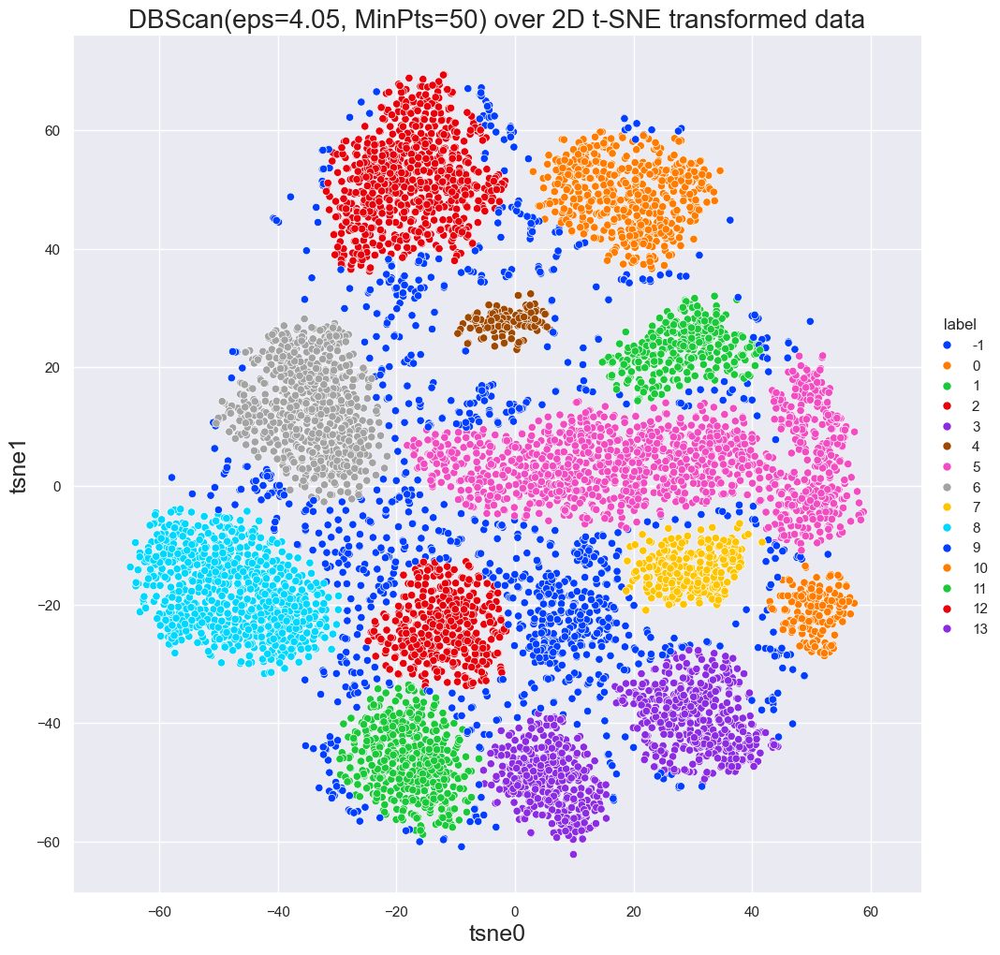

In [40]:
title = f'DBScan(eps={epsilon}, MinPts={min_samples}) over 2D t-SNE transformed data'
Plot2D_WithLabels (samples_TSNE_2D, labels_TSNE_2D, title, axes_TSNE_2D)

### t-SNE 3D

#### Reducción de Dimensión

In [41]:
tsne3D = TSNE(n_components=3)
samples_TSNE_3D = tsne2D.fit_transform(dataset2)
df_samples_TSNE_3D = pd.DataFrame(data=samples_TSNE_3D, columns=["tsne0", "tsne1"])

#### Modelación Nearest Neighbor

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


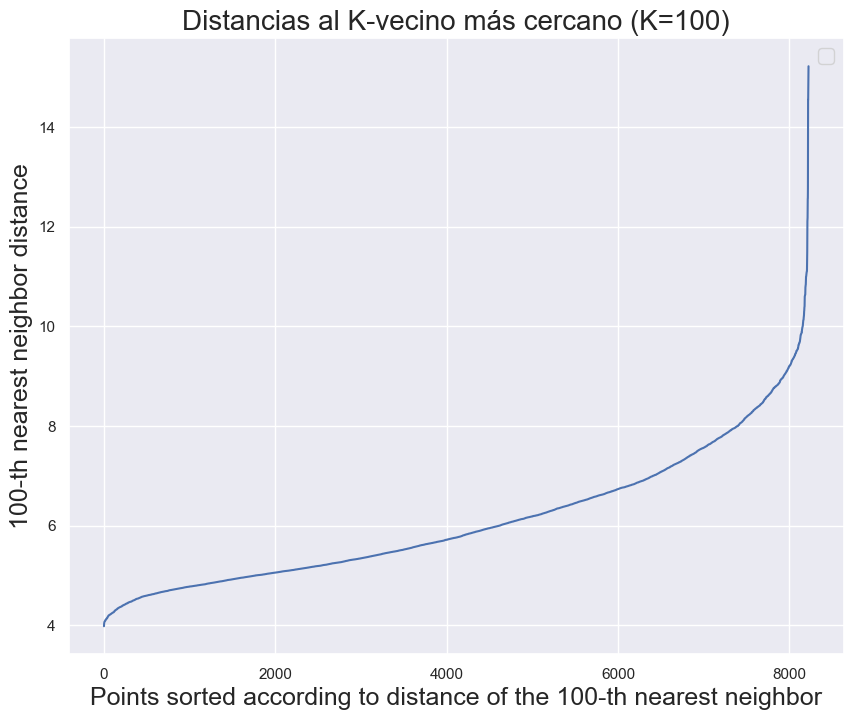

In [42]:
PlotDistancesToKnearestNeighbor(samples_TSNE_3D, 100)

### DBScan t-SNE 3D

#### Epsilons Score Silhouette

In [43]:
min_samples = 100
epsilon_values = [4.5, 5, 5.5, 5.7, 5.9, 5.95, 6, 6.1, 6.2, 6.3, 6.5, 6.6,6.7, 6.9, 7, 7.5]
aux_labels = {}
for epsilon in epsilon_values:
  aux_labels[epsilon] = ApplyDBScanToData (samples_TSNE_3D, epsilon, min_samples=min_samples)

epsilon = 6
labels_TSNE_3D = aux_labels[epsilon]


Test for epsilon = 4.5
Estimated number of clusters: 11
Estimated number of noise points: 6148
Silhouette Coefficient: -0.333

Test for epsilon = 5
Estimated number of clusters: 16
Estimated number of noise points: 2622
Silhouette Coefficient: 0.181

Test for epsilon = 5.5
Estimated number of clusters: 15
Estimated number of noise points: 1131
Silhouette Coefficient: 0.343

Test for epsilon = 5.7
Estimated number of clusters: 15
Estimated number of noise points: 793
Silhouette Coefficient: 0.366

Test for epsilon = 5.9
Estimated number of clusters: 15
Estimated number of noise points: 568
Silhouette Coefficient: 0.382

Test for epsilon = 5.95
Estimated number of clusters: 15
Estimated number of noise points: 511
Silhouette Coefficient: 0.386

Test for epsilon = 6
Estimated number of clusters: 15
Estimated number of noise points: 463
Silhouette Coefficient: 0.389

Test for epsilon = 6.1
Estimated number of clusters: 14
Estimated number of noise points: 391
Silhouette Coefficient: 0.367

#### Visualización t-SNE 3D

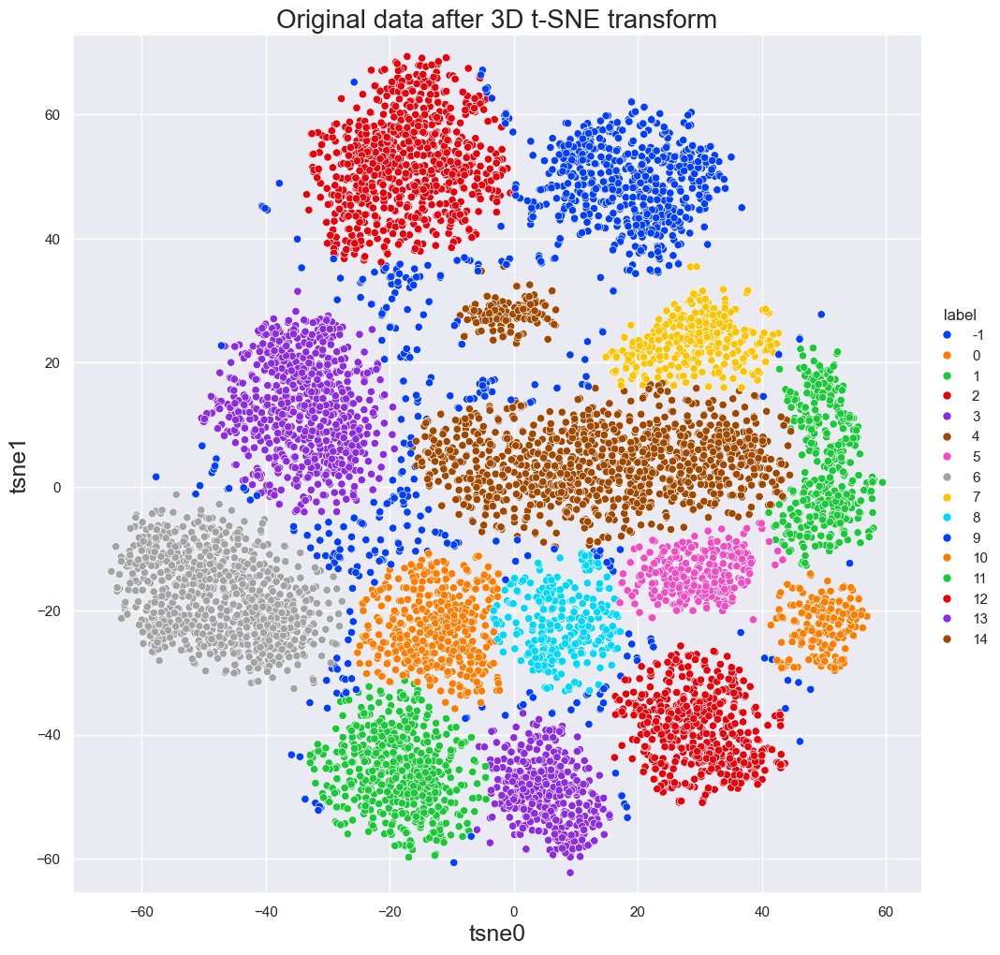

In [44]:
title = f'DBScan(eps={epsilon}, MinPts={min_samples}) over 2D t-SNE transformed data'
title = 'Original data after 3D t-SNE transform'
axes_TSNE_3D = {'x': 'tsne0', 'y': 'tsne1'}
Plot2D_WithLabels (samples_TSNE_3D, labels_TSNE_3D, title, axes_TSNE_3D)

### DBScan

#### DBScan - PCA 2D

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


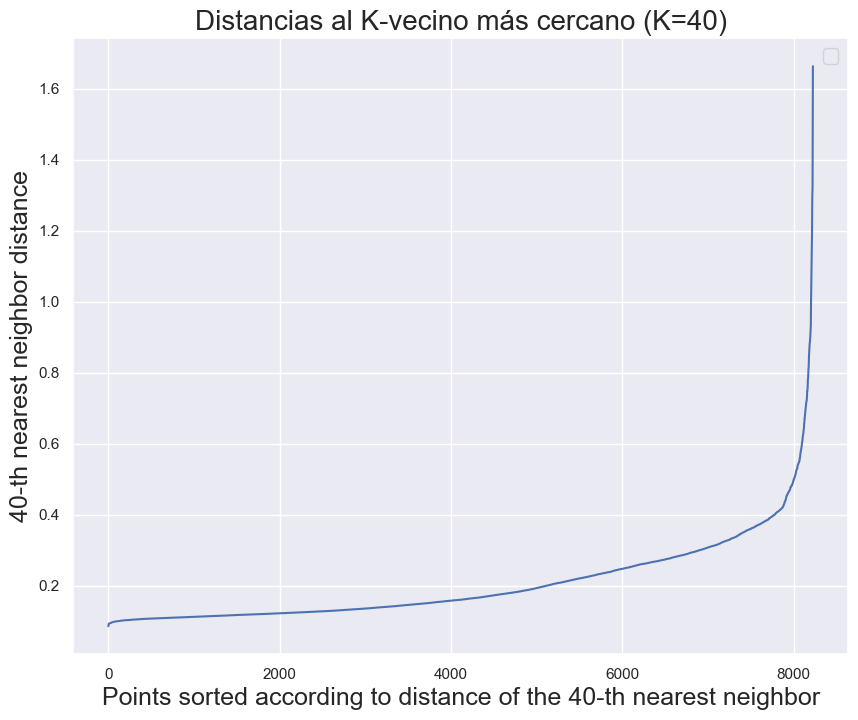

In [45]:
n_samples = 40
PlotDistancesToKnearestNeighbor(df_samples_PCA_2D, n_samples)


Test for epsilon = 0.2
Estimated number of clusters: 2
Estimated number of noise points: 4501
Silhouette Coefficient: 0.117

Test for epsilon = 0.28
Estimated number of clusters: 2
Estimated number of noise points: 2461
Silhouette Coefficient: 0.394

Test for epsilon = 0.29
Estimated number of clusters: 2
Estimated number of noise points: 2344
Silhouette Coefficient: 0.408

Test for epsilon = 0.3
Estimated number of clusters: 2
Estimated number of noise points: 2226
Silhouette Coefficient: 0.421

Test for epsilon = 0.31
Estimated number of clusters: 2
Estimated number of noise points: 2118
Silhouette Coefficient: 0.433

Test for epsilon = 0.32
Estimated number of clusters: 2
Estimated number of noise points: 2010
Silhouette Coefficient: 0.444

Test for epsilon = 0.33
Estimated number of clusters: 2
Estimated number of noise points: 1909
Silhouette Coefficient: 0.455

Test for epsilon = 0.34
Estimated number of clusters: 2
Estimated number of noise points: 1831
Silhouette Coefficient: 

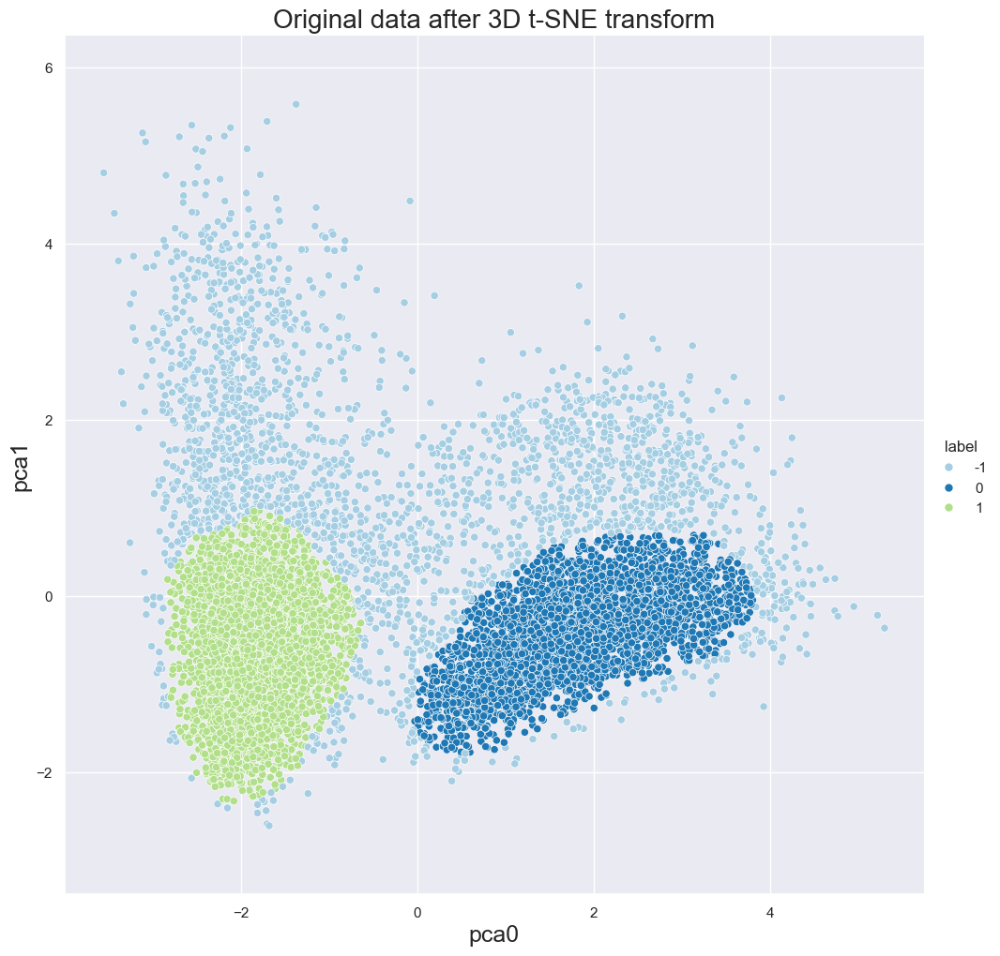

In [46]:
epsis = [0.2,0.28,0.29,0.3,0.31,0.32,0.33,0.34,0.35,0.37,0.39,0.4]
aux_labels = {}
for epsilon in epsis:
  aux_labels[epsilon] = ApplyDBScanToData (df_samples_PCA_2D, epsilon, min_samples=min_samples)

epsilon = 0.29
labels_PCA_2D = aux_labels[epsilon]
Plot2D_WithLabels (df_samples_PCA_2D, labels_PCA_2D, title, axes_PCA_2D, palette="Paired")

#### DBScan - PCA 3D

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


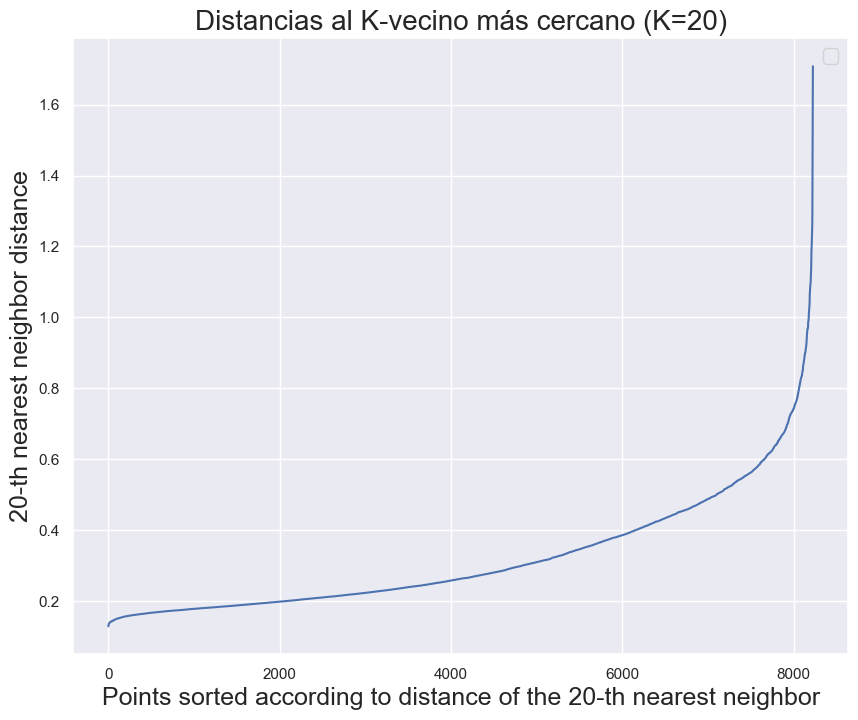

In [47]:
n_samples = 20
PlotDistancesToKnearestNeighbor(df_samples_PCA_3D, n_samples)


Test for epsilon = 0.2
Estimated number of clusters: 5
Estimated number of noise points: 4608
Silhouette Coefficient: -0.238

Test for epsilon = 0.28
Estimated number of clusters: 3
Estimated number of noise points: 2629
Silhouette Coefficient: 0.220

Test for epsilon = 0.29
Estimated number of clusters: 3
Estimated number of noise points: 2487
Silhouette Coefficient: 0.232

Test for epsilon = 0.3
Estimated number of clusters: 5
Estimated number of noise points: 2326
Silhouette Coefficient: 0.096

Test for epsilon = 0.31
Estimated number of clusters: 5
Estimated number of noise points: 2225
Silhouette Coefficient: 0.106

Test for epsilon = 0.32
Estimated number of clusters: 5
Estimated number of noise points: 2113
Silhouette Coefficient: 0.140

Test for epsilon = 0.33
Estimated number of clusters: 8
Estimated number of noise points: 1958
Silhouette Coefficient: 0.021

Test for epsilon = 0.34
Estimated number of clusters: 7
Estimated number of noise points: 1832
Silhouette Coefficient:

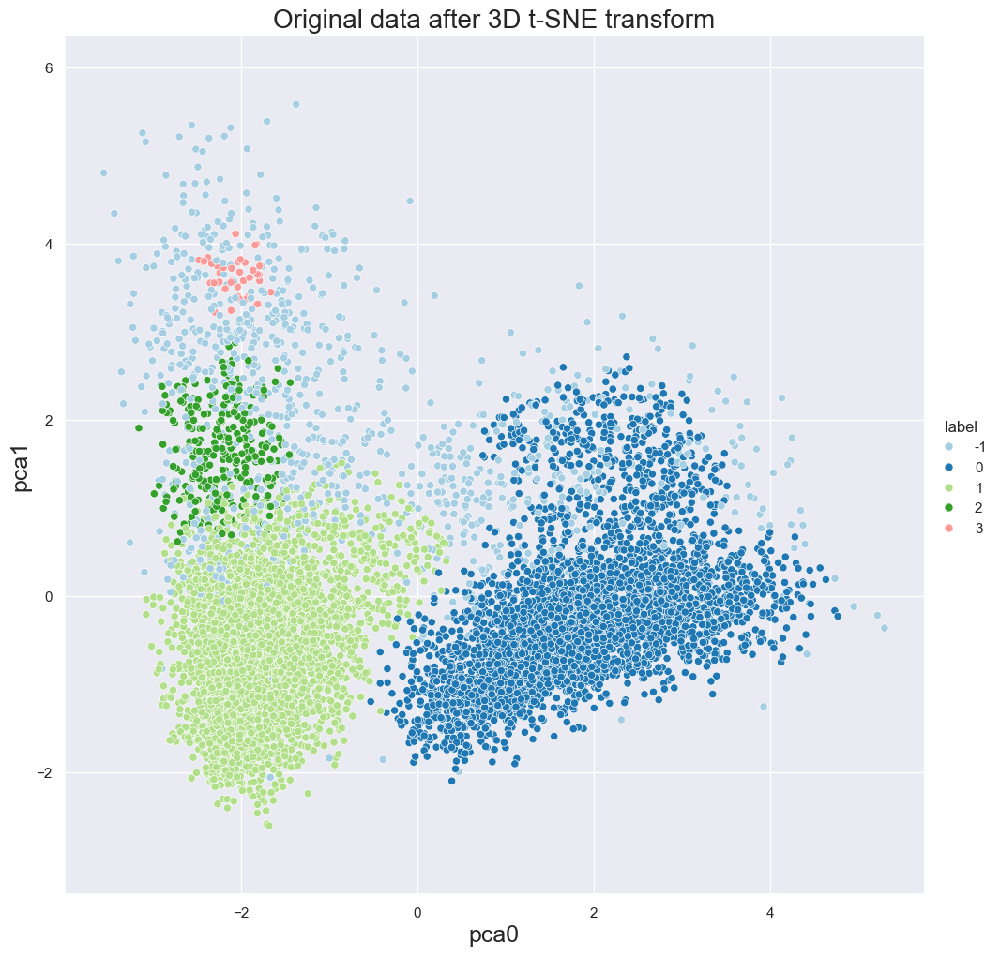

In [48]:
epsis = [0.2,0.28,0.29,0.3,0.31,0.32,0.33,0.34,0.35,0.37,0.39,0.4,0.41,0.42,0.43,0.44,0.45,0.46,0.47,0.48]
data_epsis = []
min_samples = n_samples

#epsis = [0.2,0.28,0.29,0.3,0.31,0.32,0.33,0.34,0.35,0.37,0.39,0.4]
aux_labels = {}
for epsilon in epsis:
  aux_labels[epsilon] = ApplyDBScanToData (df_samples_PCA_3D, epsilon, min_samples=min_samples)

epsilon = 0.42
labels_PCA_3D = aux_labels[epsilon]
Plot2D_WithLabels (df_samples_PCA_3D, labels_PCA_3D, title, axes_PCA_3D, palette="Paired")

## Dataset MARIA

### Cargado de Datos

In [49]:
dataset3 = np.loadtxt("EmoEvalEs-embeddings-MARIA.txt")
dataset3.shape

(8223, 768)

### Nearest Neighbor

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


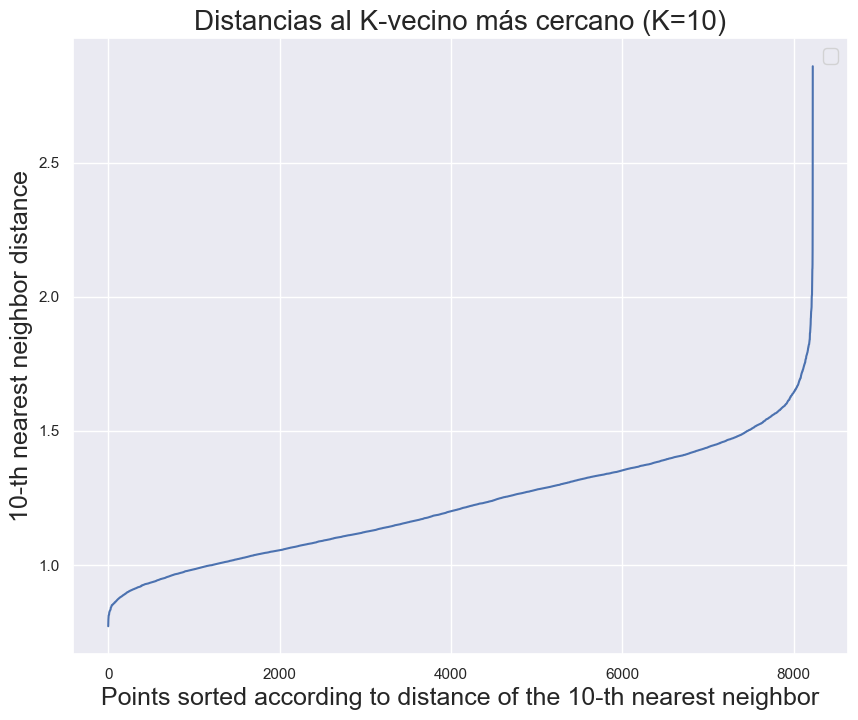

In [50]:
PlotDistancesToKnearestNeighbor(dataset3, 10)

### DBScan sin Reducción de Dimensionalidad

In [54]:
min_samples = 7
epsilon_values = [1,1.2,1.3,1.4,1.5,1.6,1.7,1.8]
aux_labels = {}
for epsilon in epsilon_values:
  aux_labels[epsilon] = ApplyDBScanToData(dataset3, epsilon, min_samples=min_samples)

epsilon = 1.4
labels = aux_labels[epsilon]


Test for epsilon = 1
Estimated number of clusters: 7
Estimated number of noise points: 5888
Silhouette Coefficient: -0.143

Test for epsilon = 1.2
Estimated number of clusters: 1
Estimated number of noise points: 3075
Silhouette Coefficient: 0.084

Test for epsilon = 1.3
Estimated number of clusters: 1
Estimated number of noise points: 1635
Silhouette Coefficient: 0.104

Test for epsilon = 1.4
Estimated number of clusters: 1
Estimated number of noise points: 697
Silhouette Coefficient: 0.129

Test for epsilon = 1.5
Estimated number of clusters: 1
Estimated number of noise points: 272
Silhouette Coefficient: 0.162

Test for epsilon = 1.6
Estimated number of clusters: 1
Estimated number of noise points: 116
Silhouette Coefficient: 0.197

Test for epsilon = 1.7
Estimated number of clusters: 1
Estimated number of noise points: 46
Silhouette Coefficient: 0.225

Test for epsilon = 1.8
Estimated number of clusters: 1
Estimated number of noise points: 18
Silhouette Coefficient: 0.267


### K-Means sin PCA

In [55]:
for i in range(2,20):
    km = KMeans(n_clusters=i, init='random', max_iter=200, random_state=0).fit(dataset3)
    sample_km = km.labels_
    score = metrics.silhouette_score(dataset3, sample_km)
    print("cantidad de cluster:", i)
    print("Silhouette Coefficient: %0.3f" % score)

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 2
Silhouette Coefficient: 0.085


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 3
Silhouette Coefficient: 0.100


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 4
Silhouette Coefficient: 0.112


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 5
Silhouette Coefficient: 0.115


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 6
Silhouette Coefficient: 0.105


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 7
Silhouette Coefficient: 0.085


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 8
Silhouette Coefficient: 0.083


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 9
Silhouette Coefficient: 0.077


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 10
Silhouette Coefficient: 0.081


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 11
Silhouette Coefficient: 0.068


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 12
Silhouette Coefficient: 0.078


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 13
Silhouette Coefficient: 0.073


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 14
Silhouette Coefficient: 0.067


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 15
Silhouette Coefficient: 0.068


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 16
Silhouette Coefficient: 0.068


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 17
Silhouette Coefficient: 0.072


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 18
Silhouette Coefficient: 0.071


C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



cantidad de cluster: 19
Silhouette Coefficient: 0.072


### PCA 2D

#### Búsqueda N° óptimo CLusters

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



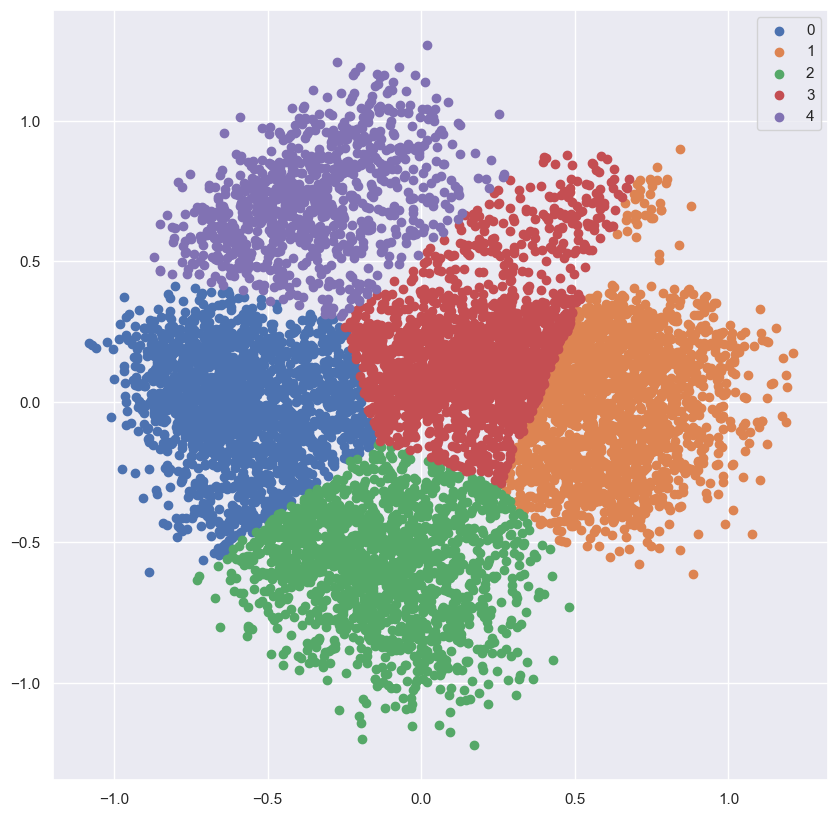

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



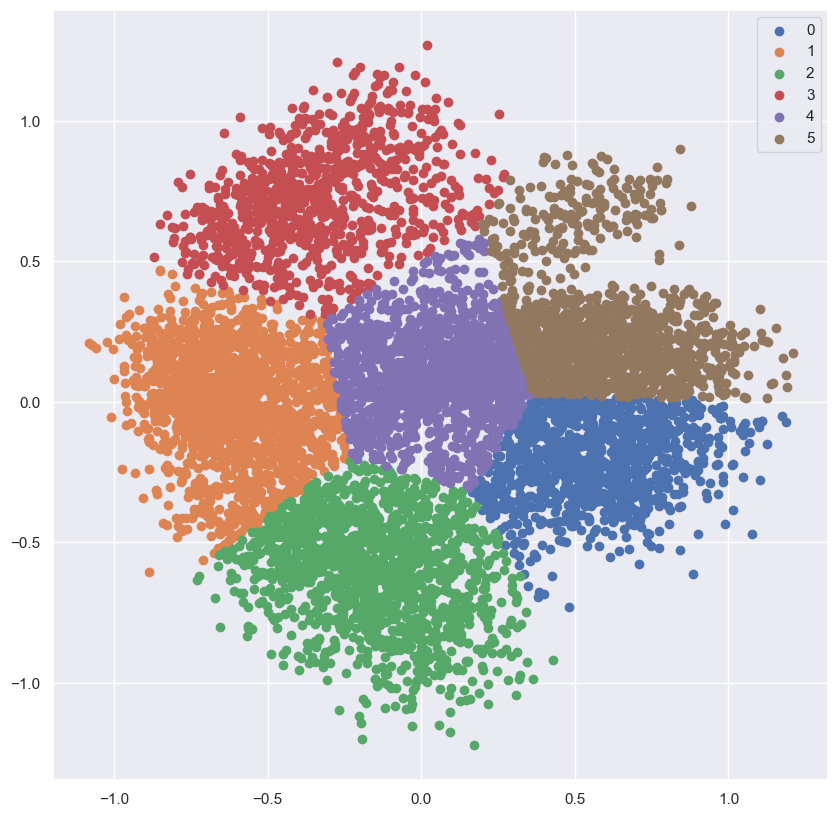

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



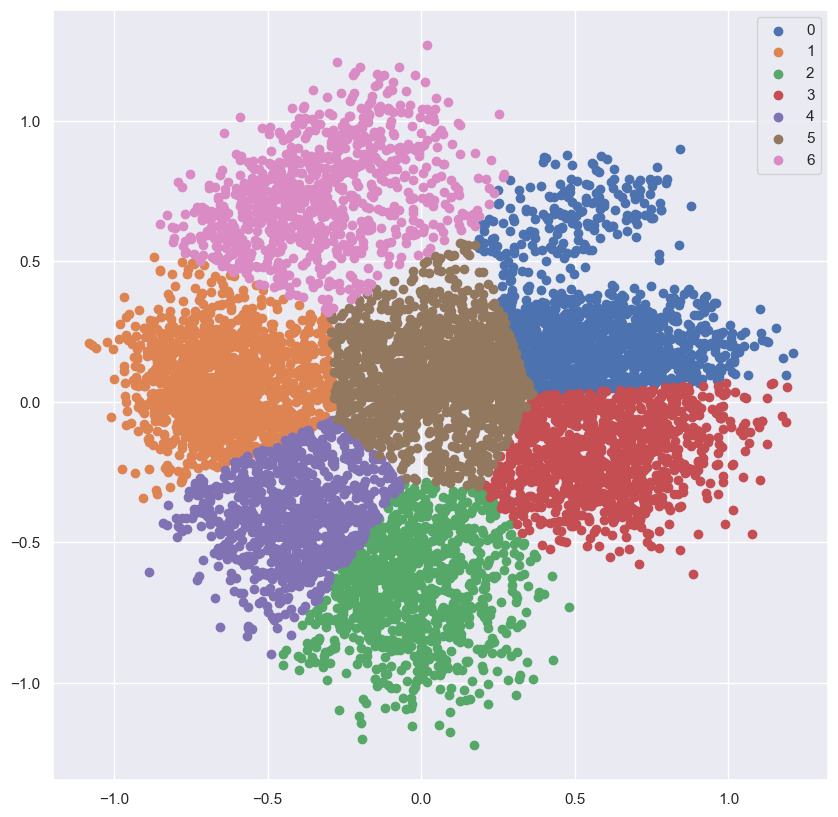

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



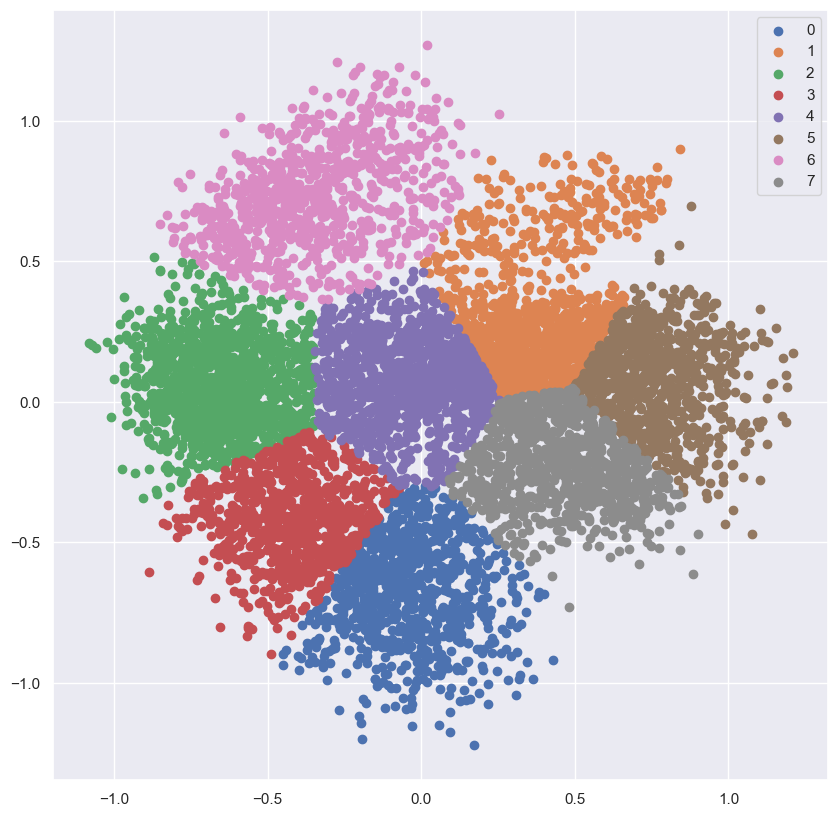

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



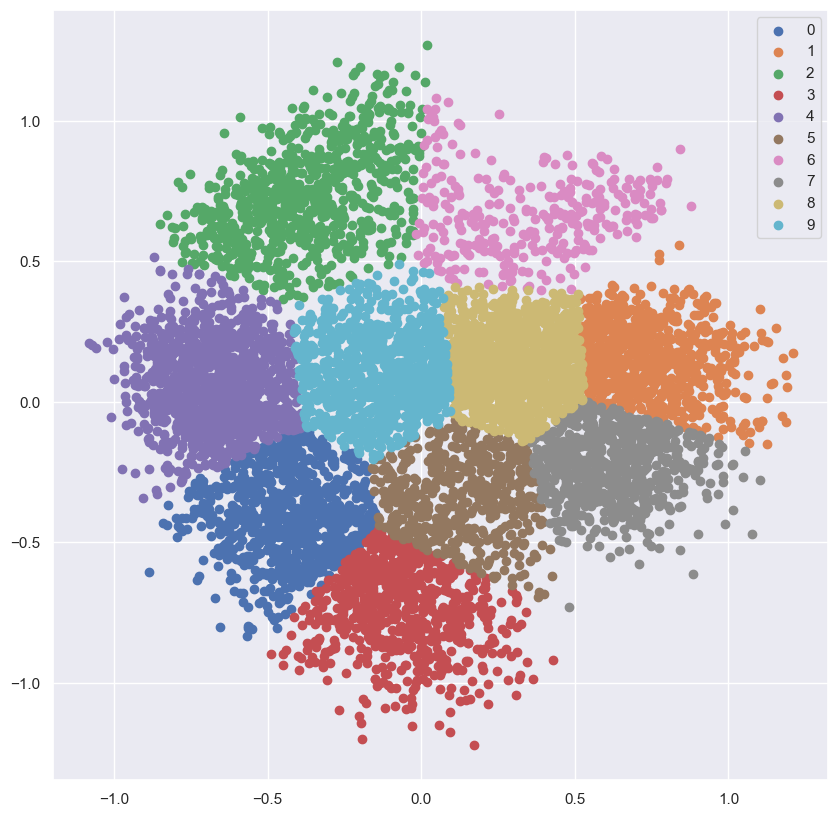

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



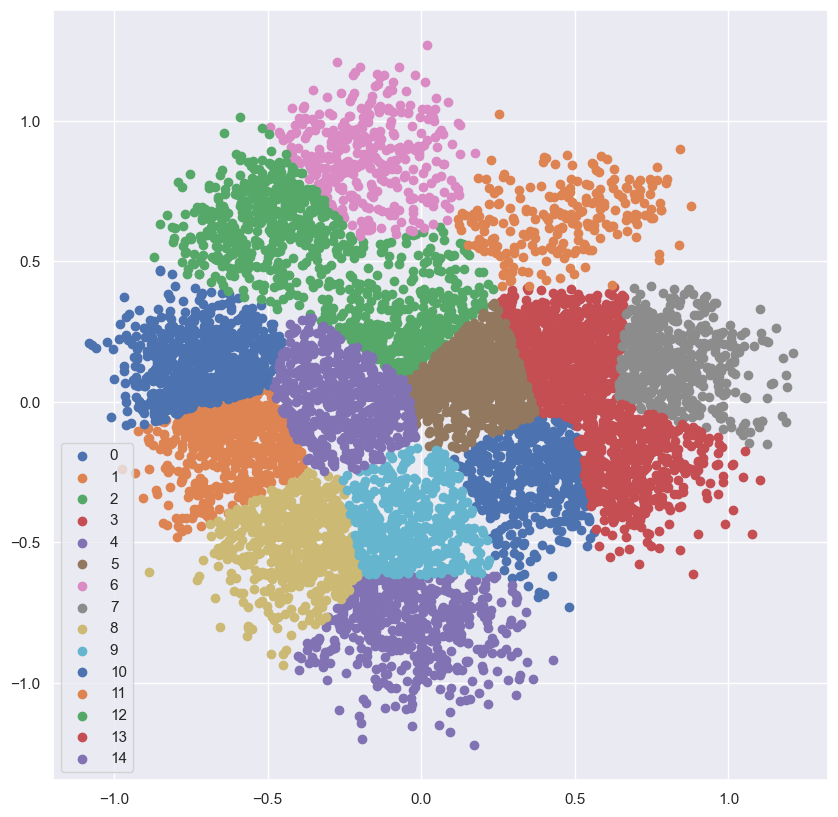

In [56]:
# Raw Data
pca2D = PCA(2)
 
#Transform the data
df_2D = pca2D.fit_transform(dataset3)

df_samples_PCA_2D = pd.DataFrame(data=df_2D, columns=["pca0", "pca1"])

clusters = [5,6,7,8,10,15]
silhouette_avg = []

for i in clusters:
    #Initialize the class object
    kmeans = KMeans(n_clusters=i)
     
    #predict the labels of clusters.
    label = kmeans.fit_predict(df_samples_PCA_2D)
     
    #Getting unique labels
    u_labels = np.unique(label)
     
    #plotting the results:
    for i in u_labels:
        plt.scatter(df_2D[label == i , 0] , df_2D[label == i , 1] , label = i)
    plt.legend()
    plt.show()
    
    score = silhouette_score(df_samples_PCA_2D, kmeans.labels_)
    silhouette_avg.append(score)

#### Modelacion N° clusters - Score Silhouette

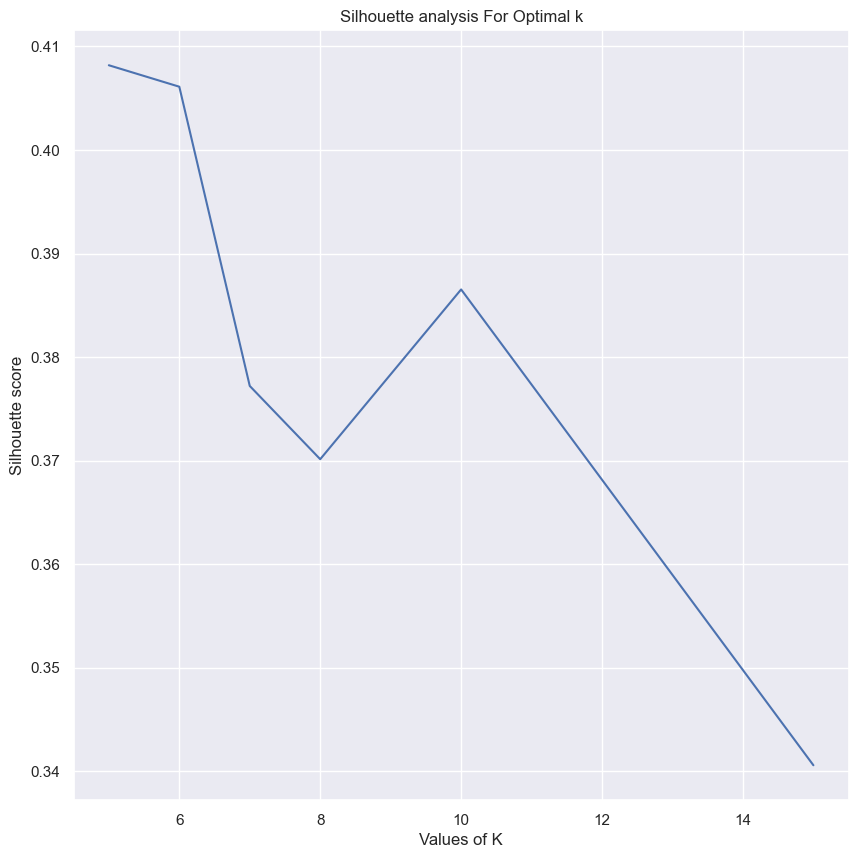

N° Clusters con mejor Score:  5 
Score:  0.40817892003676004


In [57]:
plt.plot(clusters,silhouette_avg)
plt.xlabel("Values of K") 
plt.ylabel("Silhouette score") 
plt.title("Silhouette analysis For Optimal k")
plt.show()
print("N° Clusters con mejor Score: ",clusters[pd.Series(silhouette_avg).idxmax()],"\nScore: ",max(silhouette_avg))

#### Modelado K-Means con N° Óptimo Clusters 2D

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\kevin\AppData\Local\Temp\ipykernel_10472\1159395536.py:76: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



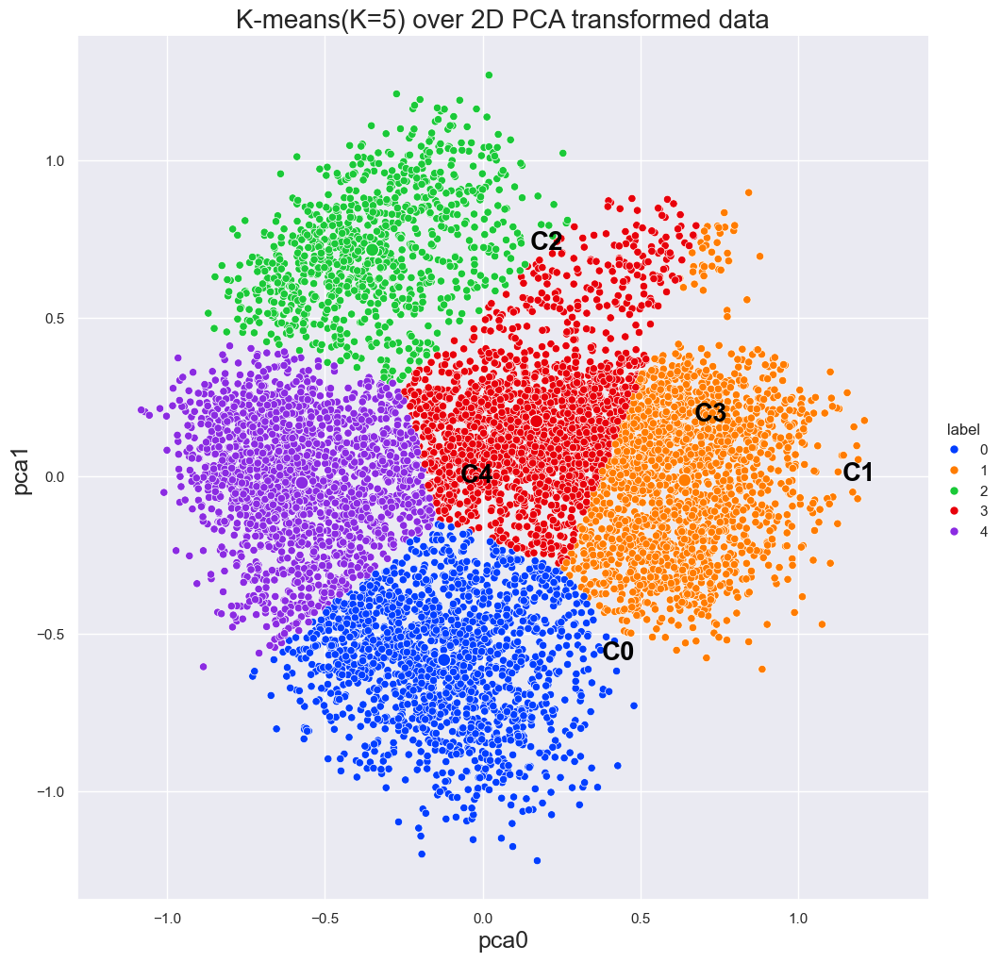

In [58]:
n_clusters = clusters[pd.Series(silhouette_avg).idxmax()]
kmeans = KMeans(n_clusters=n_clusters)
label = kmeans.fit_predict(df_samples_PCA_2D)

axes_PCA = {'x': 'pca0', 'y': 'pca1'}
title = f'K-means(K={n_clusters}) over 2D PCA transformed data'
plot = Plot2D_WithLabels(df_samples_PCA_2D, kmeans.labels_, title, axes_PCA, centroids_2D=kmeans.cluster_centers_)

### PCA 3D

#### Búsqueda N° óptimo CLusters

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



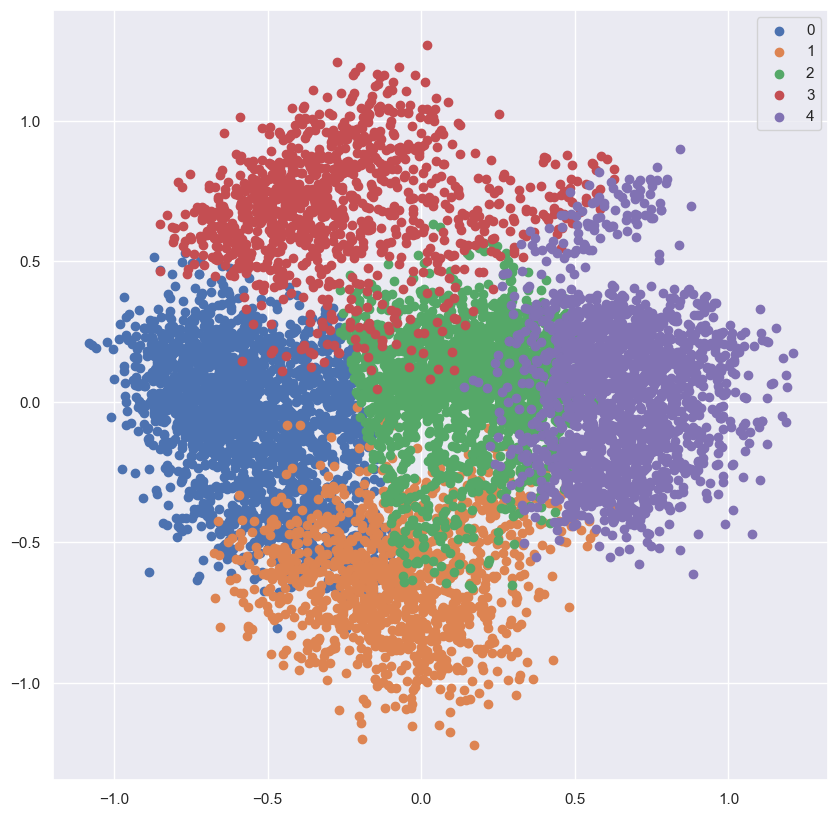

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



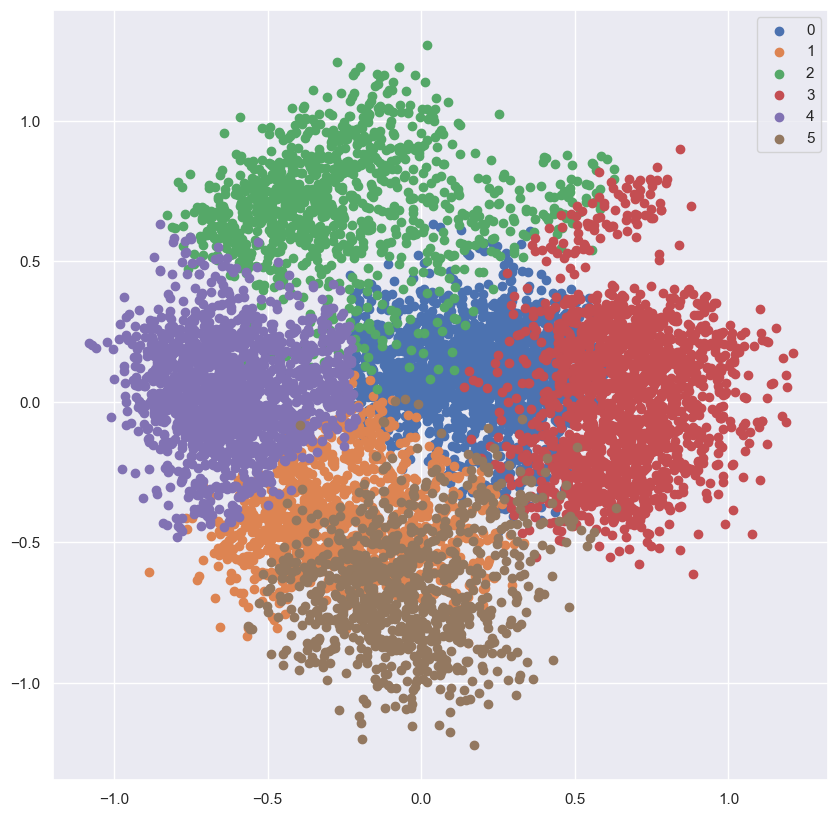

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



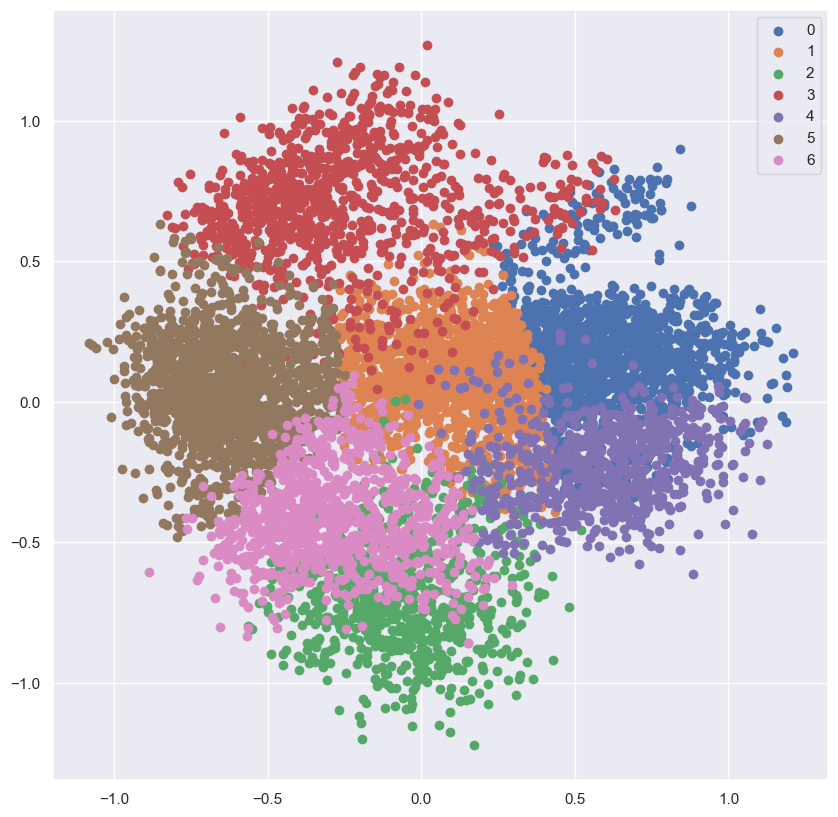

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



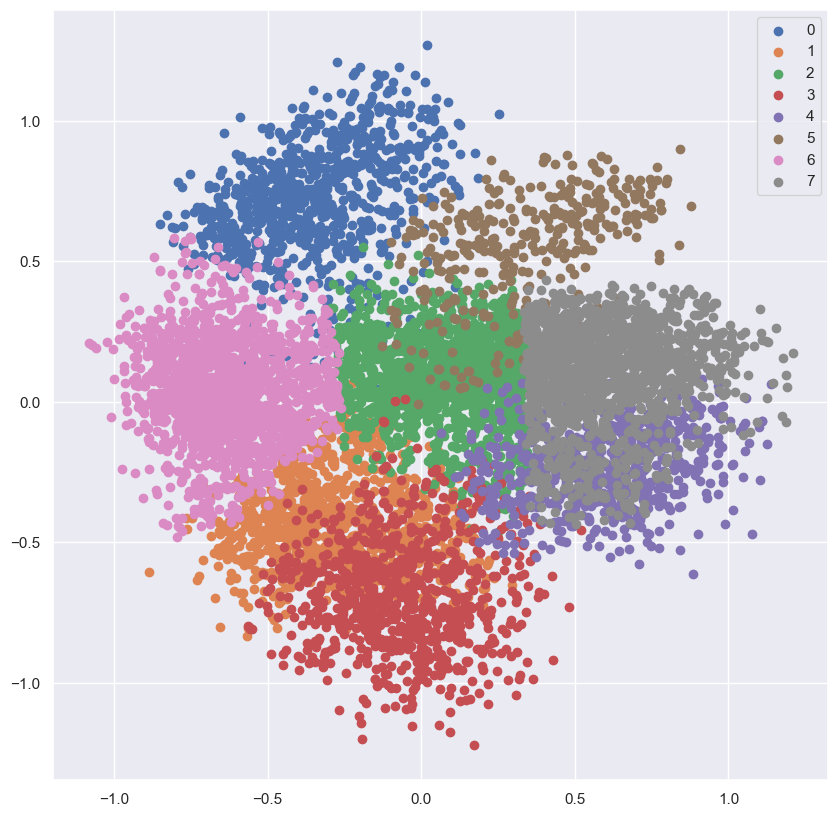

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



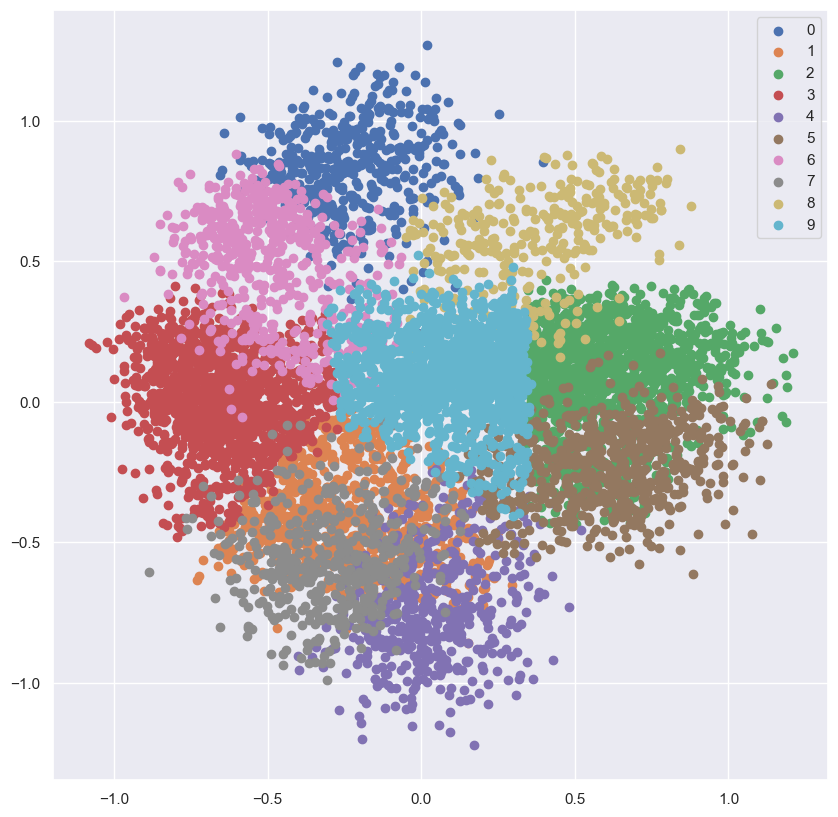

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



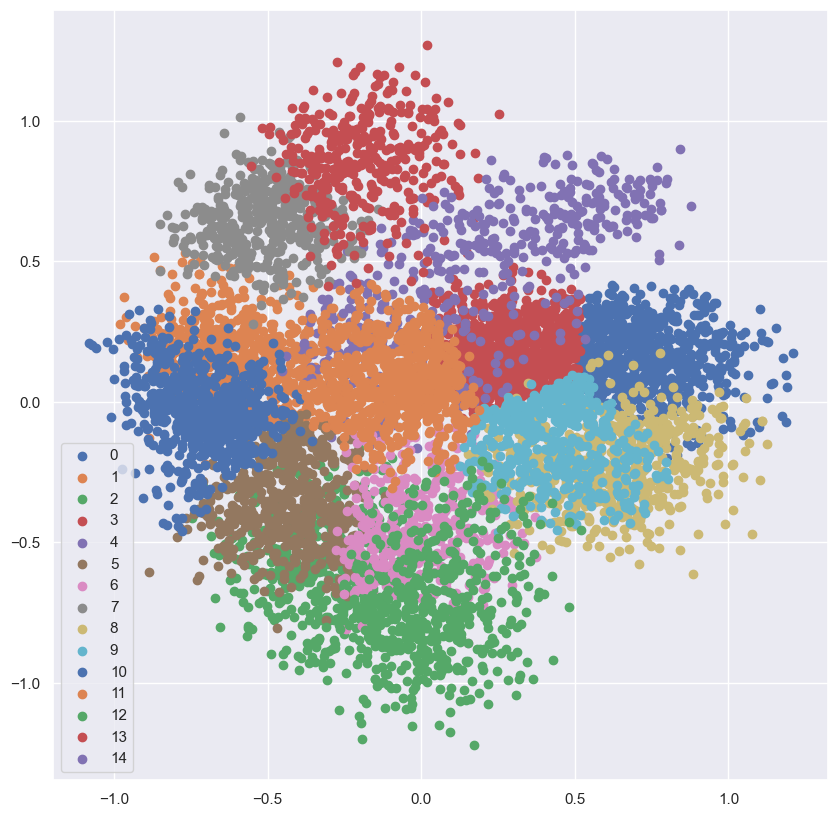

In [59]:
pca3D = PCA(n_components=3)
df_3D = pca3D.fit_transform(dataset3)
df_samples_PCA_3D = pd.DataFrame(data=df_3D, columns=["pca0", "pca1", "pca2"])

clusters = [5,6,7,8,10,15]
silhouette_avg = []

for i in clusters:
    #Initialize the class object
    kmeans = KMeans(n_clusters=i)
     
    #predict the labels of clusters.
    label = kmeans.fit_predict(df_samples_PCA_3D)
     
    #Getting unique labels
    u_labels = np.unique(label)
     
    #plotting the results:
    for i in u_labels:
        plt.scatter(df_3D[label == i , 0] , df_3D[label == i , 1] , label = i)
    plt.legend()
    plt.show()
    
    score = silhouette_score(df_samples_PCA_3D, kmeans.labels_)
    silhouette_avg.append(score)

#### Modelacion N° clusters - Score Silhouette

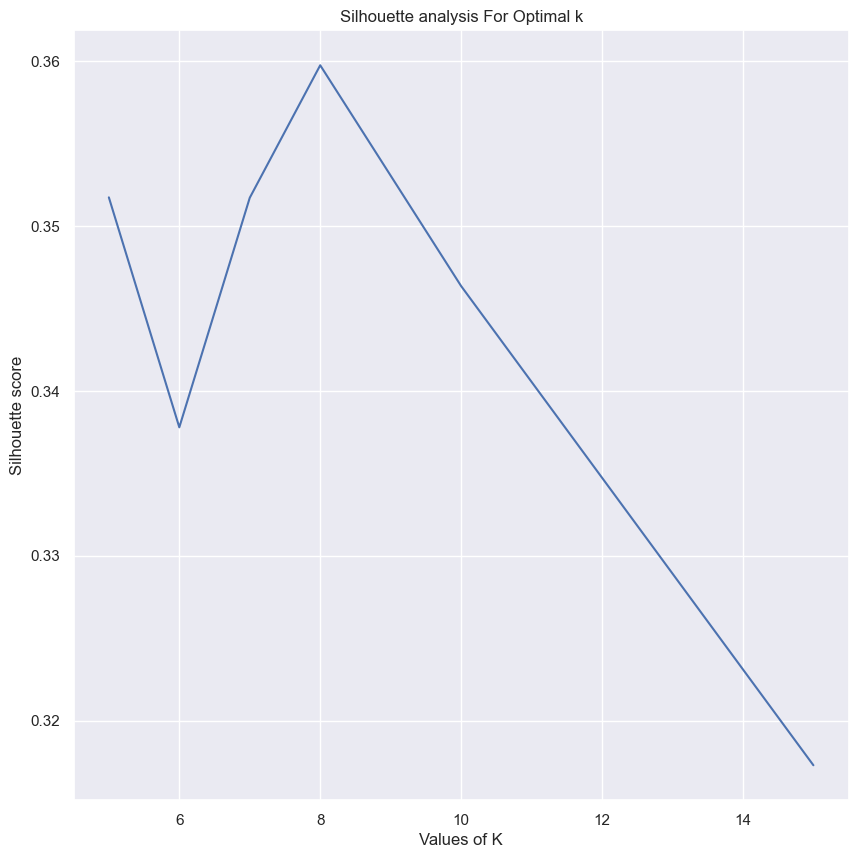

N° Clusters con mejor Score:  8 
Score:  0.35976579154196786


In [60]:
plt.plot(clusters,silhouette_avg)
plt.xlabel("Values of K") 
plt.ylabel("Silhouette score") 
plt.title("Silhouette analysis For Optimal k")
plt.show()
print("N° Clusters con mejor Score: ",clusters[pd.Series(silhouette_avg).idxmax()],"\nScore: ",max(silhouette_avg))

#### Modelado K-Means con N° Óptimo Clusters 3D

In [61]:
n_clusters = clusters[pd.Series(silhouette_avg).idxmax()]
kmeans = KMeans(n_clusters=n_clusters)
label = kmeans.fit_predict(df_samples_PCA_3D)
axes_PCA_3D = {'x': 'pca0', 'y': 'pca1', 'z': 'pca2'}

title = f'K-means(K={n_clusters}) over 3D PCA transformed data'
plot = Plot3D_WithLabels (df_samples_PCA_3D, kmeans.labels_, title, axes_PCA_3D, centroids_3D=kmeans.cluster_centers_)

C:\Users\kevin\anaconda3\envs\apau\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



### t-SNE 2D

#### Reducción de Dimensión

In [62]:
tsne2D = TSNE(n_components=2)
samples_TSNE_2D = tsne2D.fit_transform(dataset3)
df_samples_TSNE_2D = pd.DataFrame(data=samples_TSNE_2D, columns=["tsne0", "tsne1"])

#### Visualización t-SNE 2D

C:\Users\kevin\AppData\Local\Temp\ipykernel_10472\1159395536.py:17: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



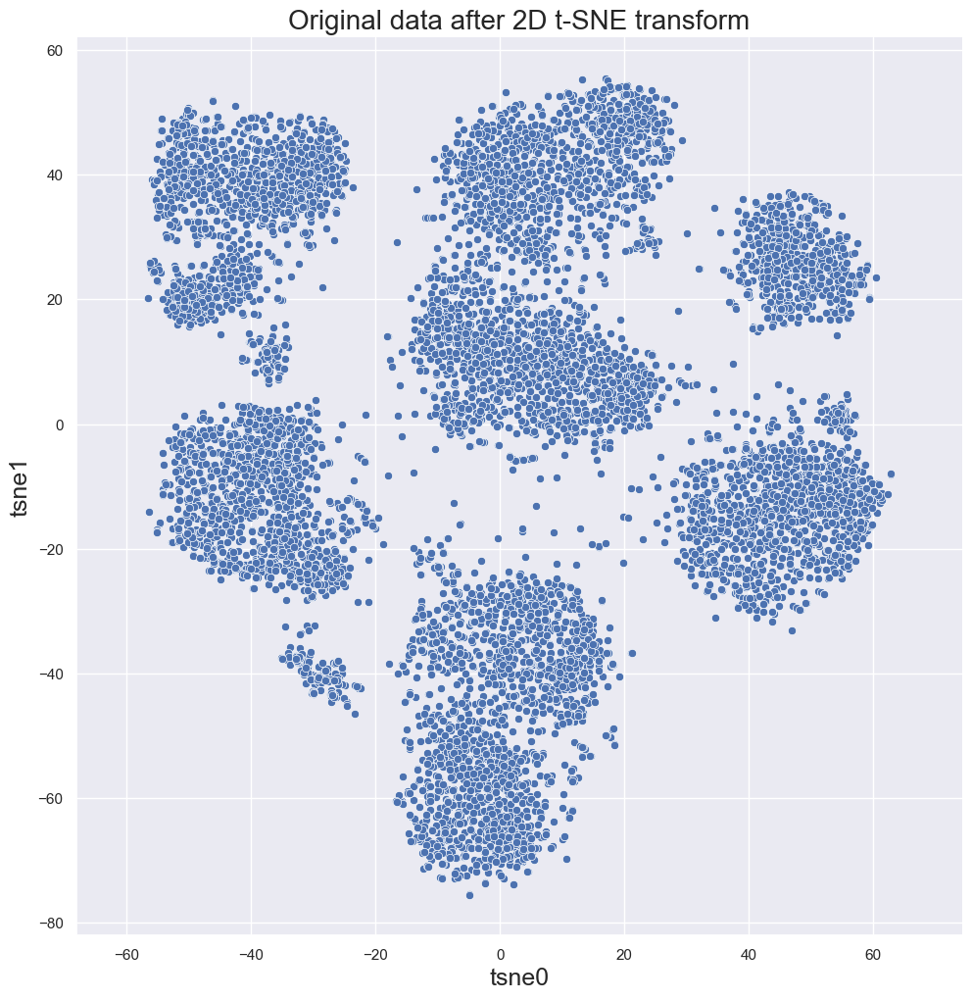

In [63]:
title = 'Original data after 2D t-SNE transform'
axes_TSNE_2D = {'x': 'tsne0', 'y': 'tsne1'}
Plot2D (samples_TSNE_2D, title, axes_TSNE_2D)

#### DBScan t-SNE 2D

##### Modelación Nearest Neighbor

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


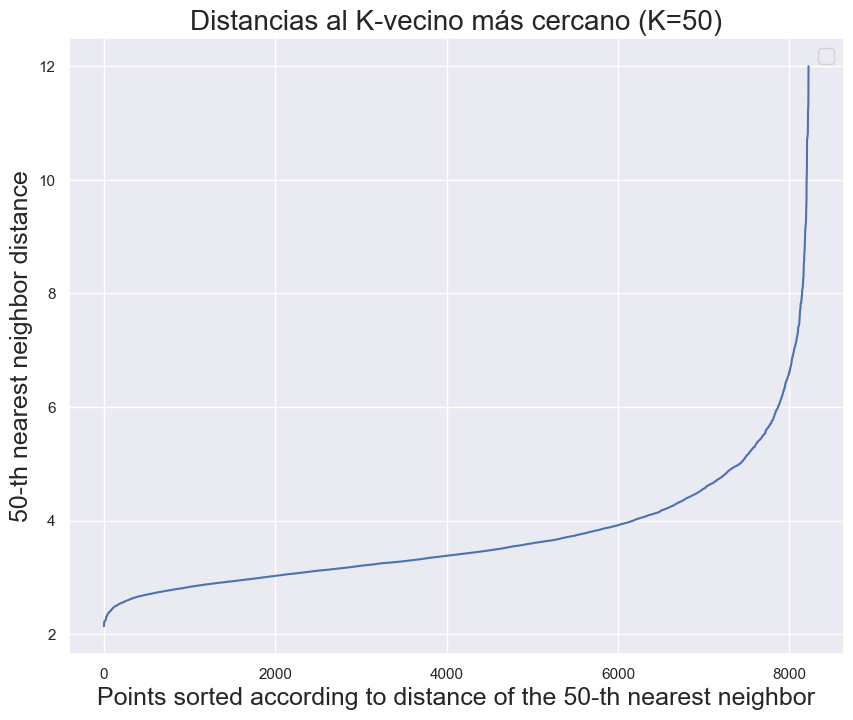

In [64]:
PlotDistancesToKnearestNeighbor(samples_TSNE_2D, 50)

##### Epsilons Score Silhouette 

In [65]:
min_samples = 50
epsilon_values = [3.9, 4, 4.05, 4.055,4.1, 4.3, 4.5, 4.7, 4.9, 5, 5.2, 5.4, 5.6, 5.8]
aux_labels = {}
for epsilon in epsilon_values:
  aux_labels[epsilon] = ApplyDBScanToData (samples_TSNE_2D, epsilon, min_samples=min_samples)

epsilon = 4.05
labels_TSNE_2D = aux_labels[epsilon]


Test for epsilon = 3.9
Estimated number of clusters: 10
Estimated number of noise points: 455
Silhouette Coefficient: 0.429

Test for epsilon = 4
Estimated number of clusters: 9
Estimated number of noise points: 402
Silhouette Coefficient: 0.410

Test for epsilon = 4.05
Estimated number of clusters: 9
Estimated number of noise points: 386
Silhouette Coefficient: 0.412

Test for epsilon = 4.055
Estimated number of clusters: 9
Estimated number of noise points: 380
Silhouette Coefficient: 0.412

Test for epsilon = 4.1
Estimated number of clusters: 9
Estimated number of noise points: 345
Silhouette Coefficient: 0.415

Test for epsilon = 4.3
Estimated number of clusters: 9
Estimated number of noise points: 274
Silhouette Coefficient: 0.421

Test for epsilon = 4.5
Estimated number of clusters: 9
Estimated number of noise points: 226
Silhouette Coefficient: 0.425

Test for epsilon = 4.7
Estimated number of clusters: 8
Estimated number of noise points: 143
Silhouette Coefficient: 0.373

Test 

##### Visualización DBScan

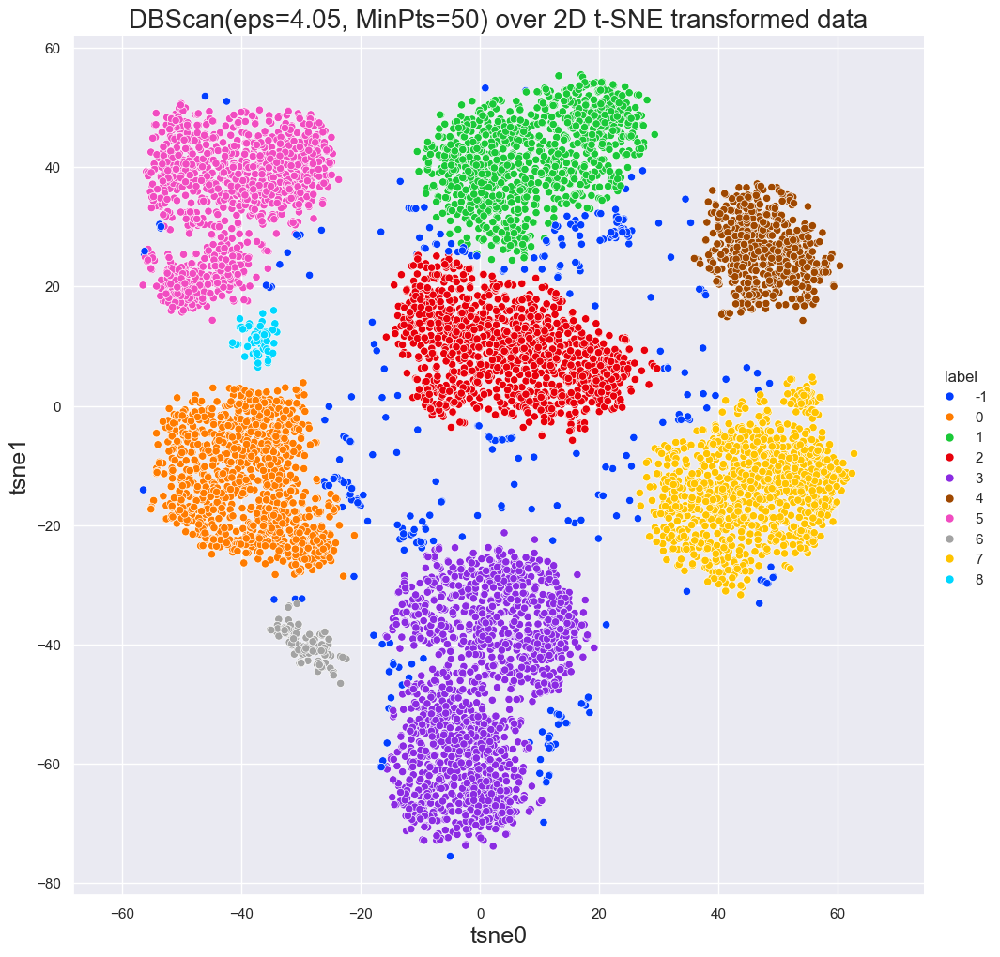

In [66]:
title = f'DBScan(eps={epsilon}, MinPts={min_samples}) over 2D t-SNE transformed data'
Plot2D_WithLabels (samples_TSNE_2D, labels_TSNE_2D, title, axes_TSNE_2D)

### t-SNE 3D

#### Reducción de Dimensión

In [67]:
tsne3D = TSNE(n_components=3)
samples_TSNE_3D = tsne2D.fit_transform(dataset3)
df_samples_TSNE_3D = pd.DataFrame(data=samples_TSNE_3D, columns=["tsne0", "tsne1"])

#### Modelación Nearest Neighbor

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


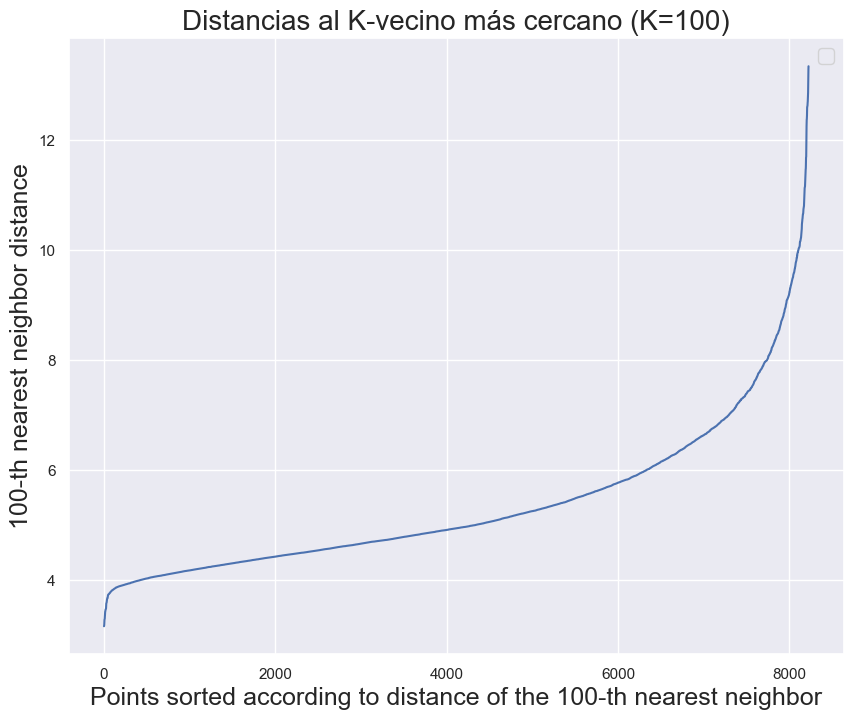

In [68]:
PlotDistancesToKnearestNeighbor(samples_TSNE_3D, 100)

### DBScan t-SNE 3D

#### Epsilons Score Silhouette

In [69]:
min_samples = 100
epsilon_values = [4.5, 5, 5.5, 5.7, 5.9, 5.95, 6, 6.1, 6.2, 6.3, 6.5, 6.6,6.7, 6.9, 7, 7.5]
aux_labels = {}
for epsilon in epsilon_values:
  aux_labels[epsilon] = ApplyDBScanToData (samples_TSNE_3D, epsilon, min_samples=min_samples)

epsilon = 6
labels_TSNE_3D = aux_labels[epsilon]


Test for epsilon = 4.5
Estimated number of clusters: 12
Estimated number of noise points: 2199
Silhouette Coefficient: 0.230

Test for epsilon = 5
Estimated number of clusters: 9
Estimated number of noise points: 923
Silhouette Coefficient: 0.435

Test for epsilon = 5.5
Estimated number of clusters: 8
Estimated number of noise points: 398
Silhouette Coefficient: 0.478

Test for epsilon = 5.7
Estimated number of clusters: 8
Estimated number of noise points: 327
Silhouette Coefficient: 0.484

Test for epsilon = 5.9
Estimated number of clusters: 8
Estimated number of noise points: 246
Silhouette Coefficient: 0.489

Test for epsilon = 5.95
Estimated number of clusters: 8
Estimated number of noise points: 244
Silhouette Coefficient: 0.489

Test for epsilon = 6
Estimated number of clusters: 8
Estimated number of noise points: 228
Silhouette Coefficient: 0.490

Test for epsilon = 6.1
Estimated number of clusters: 8
Estimated number of noise points: 199
Silhouette Coefficient: 0.492

Test for

#### Visualización t-SNE 3D

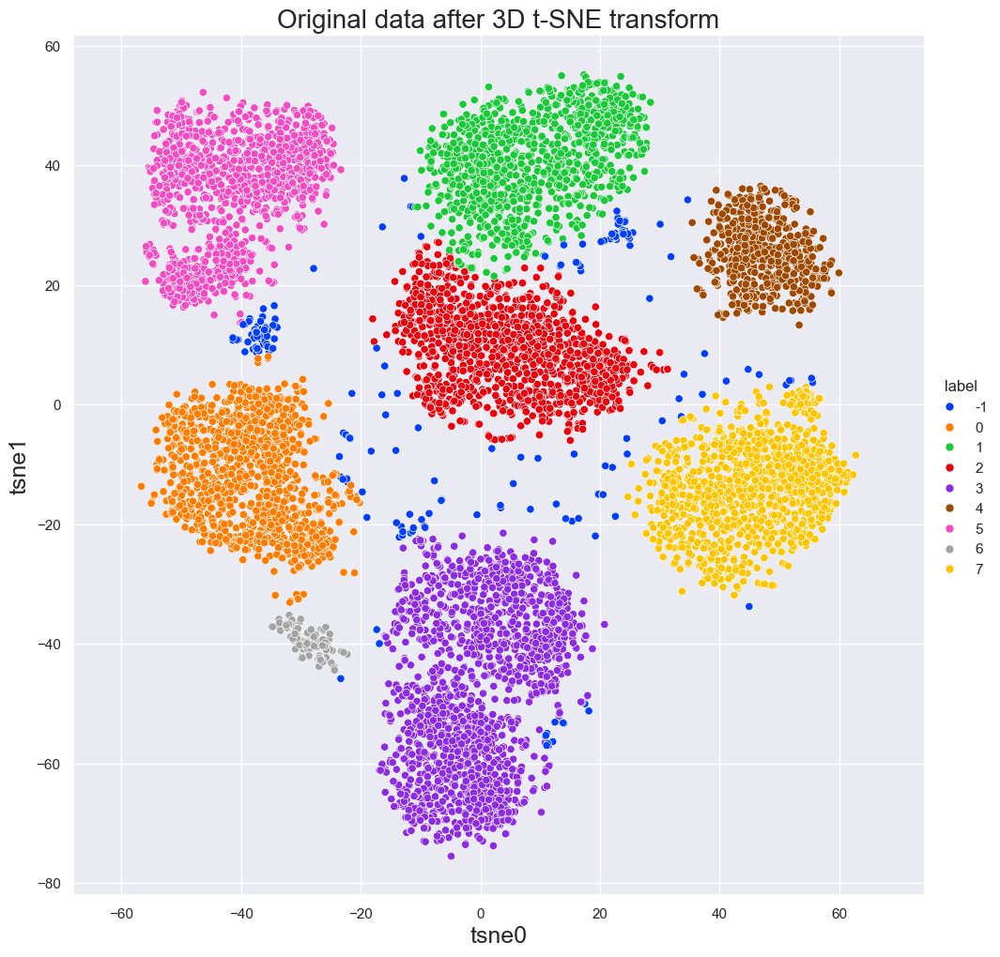

In [70]:
title = f'DBScan(eps={epsilon}, MinPts={min_samples}) over 2D t-SNE transformed data'
title = 'Original data after 3D t-SNE transform'
axes_TSNE_3D = {'x': 'tsne0', 'y': 'tsne1'}
Plot2D_WithLabels (samples_TSNE_3D, labels_TSNE_3D, title, axes_TSNE_3D)

### DBScan

#### DBScan - PCA 2D

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


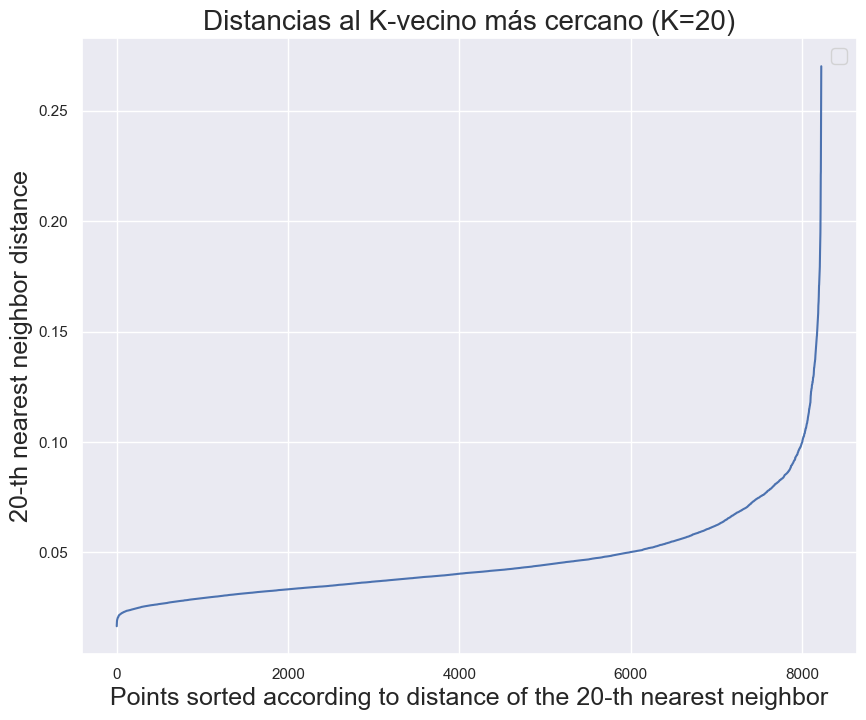

In [71]:
n_samples = 20
PlotDistancesToKnearestNeighbor(df_samples_PCA_2D, n_samples)

In [72]:
epsis = [0.01,0.09]
data_epsis = []
min_samples = 7

for epsilon in epsis:
    db = DBSCAN(eps=epsilon, min_samples=min_samples, algorithm="ball_tree", metric='minkowski', leaf_size=90, p=2).fit(df_samples_PCA_2D)
    #labels = db.labels_
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 1)
    n_noise_ = list(labels).count(-1)
    print(f"\nTest for epsilon = {epsilon}")
    print('Estimated number of clusters: %d' % n_clusters_)
    print('Estimated number of noise points: %d' % n_noise_)
    print("Silhouette Coefficient: %0.3f" % silhouette_score(df_samples_PCA_2D, labels))


Test for epsilon = 0.01
Estimated number of clusters: 1
Estimated number of noise points: 697
Silhouette Coefficient: 0.003

Test for epsilon = 0.09
Estimated number of clusters: 1
Estimated number of noise points: 697
Silhouette Coefficient: 0.003


#### DBScan - PCA 3D

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


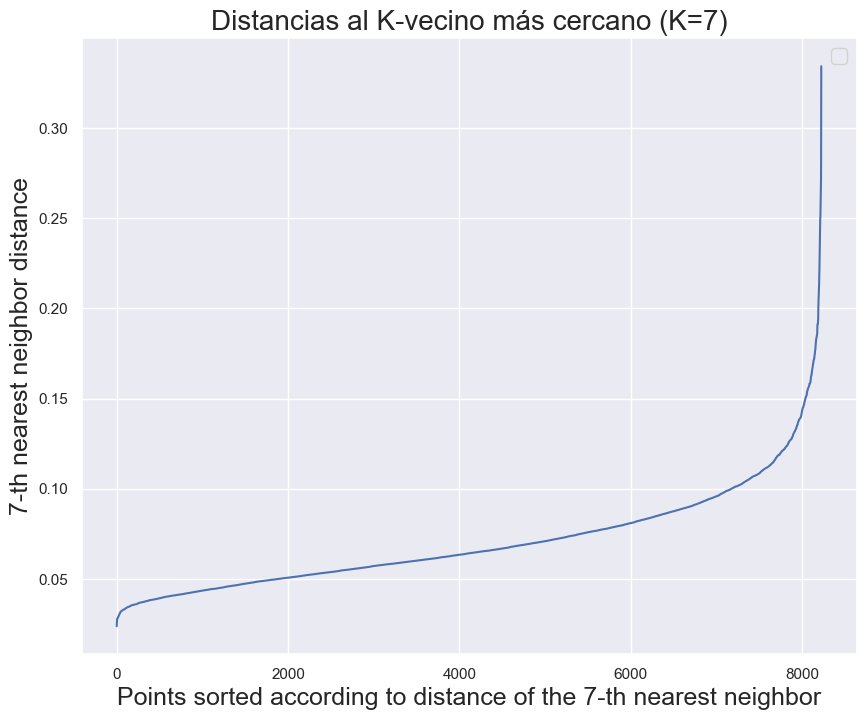

In [73]:
n_samples = 7
PlotDistancesToKnearestNeighbor(df_samples_PCA_3D, n_samples)

In [74]:
epsis = [0.09,0.0945,0.1,0.15,0.16,0.17,0.2]
data_epsis = []
min_samples = n_samples

for epsilon in epsis:
    db = DBSCAN(eps=epsilon, min_samples=min_samples, algorithm="ball_tree", leaf_size=90, p=2).fit(df_samples_PCA_3D)
    labels = db.labels_
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 1)
    n_noise_ = list(labels).count(-1)
    print(f"\nTest for epsilon = {epsilon}")
    print('Estimated number of clusters: %d' % n_clusters_)
    print('Estimated number of noise points: %d' % n_noise_)
    print("Silhouette Coefficient: %0.3f" % silhouette_score(df_samples_PCA_3D, labels))


Test for epsilon = 0.09
Estimated number of clusters: 11
Estimated number of noise points: 664
Silhouette Coefficient: -0.282

Test for epsilon = 0.0945
Estimated number of clusters: 8
Estimated number of noise points: 519
Silhouette Coefficient: -0.132

Test for epsilon = 0.1
Estimated number of clusters: 4
Estimated number of noise points: 383
Silhouette Coefficient: -0.153

Test for epsilon = 0.15
Estimated number of clusters: 1
Estimated number of noise points: 45
Silhouette Coefficient: 0.220

Test for epsilon = 0.16
Estimated number of clusters: 1
Estimated number of noise points: 28
Silhouette Coefficient: 0.210

Test for epsilon = 0.17
Estimated number of clusters: 1
Estimated number of noise points: 19
Silhouette Coefficient: 0.209

Test for epsilon = 0.2
Estimated number of clusters: 1
Estimated number of noise points: 5
Silhouette Coefficient: 0.119
